# (1) Расчёт вертикального напряжения и пластового давления

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import os
import lasio
from scipy import stats
from scipy.optimize import curve_fit
from math import *

#%matplotlib qt

## Загрузка данных ГИС и отображение датафрейма с исходными данными ГИС

In [2]:
cwd = os.getcwd()  # смена директории на текущую
# чтение файлов в текущей директории
for file in os.listdir(cwd):
    if file.endswith('.las'):
        las = lasio.read(os.path.join(cwd, file), ignore_header_errors=True)
        df = las.df().reset_index()
df

,MD,AZI,BS,CALI,DCAL,DEV,DRHO,DTC,DTS,GR,NPHI,PEF,RDEP,RHOB,RMED
0,0.0,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.1,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.2,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.3,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.4,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39027,3902.7,0.0,8.5,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,2.970829,NaN,3.087276
39028,3902.8,0.0,8.5,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,2.960968,NaN,3.078955
39029,3902.9,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39030,3903.0,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


MD (measured depth) = измеренная глубина; AZI (azimuth) = азимут; BS = диаметр долота; CALI = каверномер; DCAL = поправка на каверномер; DEV (deviation angle) = зенитный угол; DRHO = поправка на плотность; DTC = акустический каротаж (p-волна); DTS = акустический каротаж (s-волна); GR = гамма-каротаж; NPHI = нейтронная пористость; PEF = фотоэлектронный фактор; RDEP = дальняя зона по сопротивлениям; RHOB = объёмная плотность (гамма-гамма плотностной каротаж); RMED = средняя зона по сопротивлениям

## Посторение планшета с ГИС

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/4007707890.py:4: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot2grid((1, 3), (0, 0), rowspan=1, colspan=1)


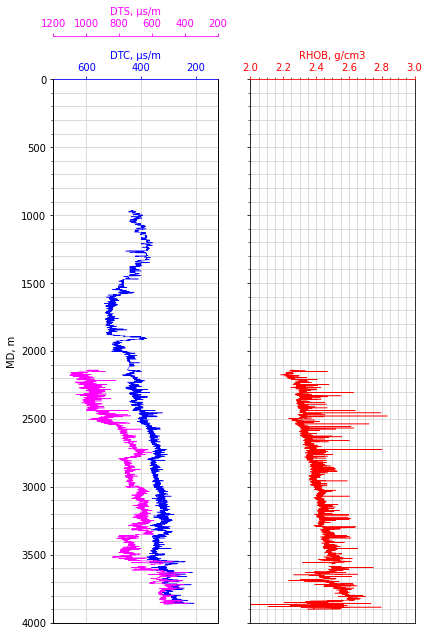

In [3]:
# построение профилей исходных данных ГИС
fig = plt.subplots(figsize=(10, 10))
# ax1 - график для DTC/DTP (кросс-дипольный акустический каротаж)
ax1 = plt.subplot2grid((1, 3), (0, 0), rowspan=1, colspan=1)
# ax2 - график для DTS (широкополостный акустический каротаж); строится там же, что и ax1
ax2 = ax1.twiny()
# ax3 - график для RHOB (гамма-гамма плотностной каротаж)
ax3 = plt.subplot2grid((1, 3), (0, 1), rowspan=1, colspan=1, sharey=ax1)

ax1_color = 'blue'
ax2_color = 'magenta'
ax3_color = 'red'

# DTC
# построение графика
ax1.plot(df['DTC'], df['MD'], color=ax1_color, lw=0.5)
# установка границ диапазона по оси абсцисс
ax1.set_xlim(720, 120)
# установка границ диапазона по оси ординат
ax1.set_ylim(4000, 0)
# создание подписей к осям
ax1.set_xlabel('DTC, μs/m')
ax1.set_ylabel('MD, m')
# присвоение цвета подписи
ax1.xaxis.label.set_color(ax1_color)
# расположение подписи к обозначению линии
ax1.spines['top'].set_position(('axes', 1.00))
# присвоение цвета отметкам основных линий сетки
ax1.tick_params(axis='x', colors=ax1_color)
# присвоение цвета оси
ax1.spines['top'].set_edgecolor(ax1_color)
# создание сетки
ax1.grid(which='both', color='lightgrey', linestyle='-')
# расположение главных отметок и подписи (сверху)
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')

# DTS
ax2.plot(df['DTS'], df['MD'], color=ax2_color, lw=0.5)
ax2.set_xlim(1200, 200)
ax2.set_ylim(4000, 0)
ax2.set_xlabel('DTS, μs/m')
ax2.set_ylabel('MD, m')
ax2.xaxis.label.set_color(ax2_color)
ax2.spines['top'].set_position(('axes', 1.08))
ax2.tick_params(axis='x', colors=ax2_color)
ax2.spines['top'].set_edgecolor(ax2_color)
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')

# RHOB
ax3.plot(df['RHOB'], df['MD'], color=ax3_color, lw=0.5)
ax3.set_xlim(2, 3)
ax3.set_ylim(4000, 0)
ax3.set_xlabel('RHOB, g/cm3')
ax3.xaxis.label.set_color(ax3_color)
ax3.spines['top'].set_position(('axes', 1.00))
ax3.tick_params(axis='x', colors=ax3_color)
ax3.spines['top'].set_edgecolor(ax3_color)
ax3.grid(which='both', color='lightgrey', linestyle='-')
ax3.minorticks_on()
ax3.xaxis.set_ticks_position('top')
ax3.xaxis.set_label_position('top')

plt.setp(ax3.get_yticklabels(), visible=False)
plt.show()

## Функция расчёта TVD и отходов от вертикали (методом минимальной кривизны)

In [4]:
def tvd_calculation(
    df: pd.DataFrame
) -> pd.DataFrame:
    df['TVD'] = nan
    df['EAST'] = nan
    df['NORTH'] = nan
    df['DISPLACEMENT'] = nan
    
    df.at[0, 'TVD'] = 0
    df.at[0, 'EAST'] = 0
    df.at[0, 'NORTH'] = 0
    df.at[0, 'DISPLACEMENT'] = 0
    
    if 'DEV' in df.columns and 'AZI' in df.columns:
        for i, row in df.iloc[1:].iterrows():
            i1 = radians(df.at[i-1, 'DEV'])
            i2 = radians(df.at[i, 'DEV'])
            a1 = radians(df.at[i-1, 'AZI'])
            a2 = radians(df.at[i, 'AZI'])
            beta = radians(acos(cos(i2 - i1) - sin(i1) * sin(i2) * (1 - cos(a2 - a1))))
            if beta == 0:
                df.at[i, 'TVD'] = df.at[i-1, 'TVD'] + (df.at[i, 'MD'] - df.at[i-1, 'MD']) * cos(i2)
                df.at[i, 'EAST'] = df.at[i-1, 'EAST'] + (df.at[i, 'MD'] - df.at[i-1, 'MD']) * sin(i2) * sin(a2)
                df.at[i, 'NORTH'] = df.at[i-1, 'NORTH'] + (df.at[i, 'MD'] - df.at[i-1, 'MD']) * sin(i2) * cos(a2)
            else:
                rf = 2 / beta * tan(beta / 2)
                df.at[i, 'TVD'] = df.at[i-1, 'TVD'] + (df.at[i, 'MD'] - df.at[i-1, 'MD']) / 2 * (cos(i1) + cos(i2)) * rf
                df.at[i, 'EAST'] = df.at[i-1, 'EAST'] + (df.at[i, 'MD'] - df.at[i-1, 'MD']) / 2 * \
                    (sin(i1) * sin(a1) + sin(i2) * sin(a2)) * rf
                df.at[i, 'NORTH'] = df.at[i-1, 'NORTH'] + (df.at[i, 'MD'] - df.at[i-1, 'MD']) / 2 * \
                    (sin(i1) * cos(a1) + sin(i2) * cos(a2)) * rf
            df.at[i, 'DISPLACEMENT'] = sqrt((df.at[i, 'NORTH']) ** 2 + (df.at[i, 'EAST']) ** 2)
    else:
        for i, row in df.iterrows():
            df.at[i, 'TVD'] = df.at[i, 'MD']
            df.at[i, 'DISPLACEMENT'] = sqrt((df.at[i, 'NORTH']) ** 2 + (df.at[i, 'EAST']) ** 2)
    
    return df

## Расчёт TVD и отходов от вертикали

In [5]:
df = tvd_calculation(df)

## Построение проекций и 3D графика траектории

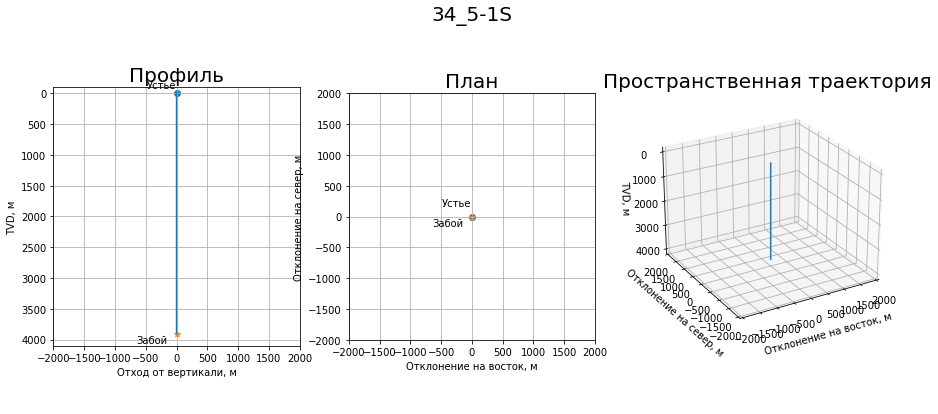

In [6]:
# построение графиков траектории
fig = plt.figure(figsize=(15,7))
# подпись графиков
plt.title('34_5-1S', fontsize = 20)
# отключение рамки вокруг области построения
plt.axis("off")
# задание предельных значений для осей
#limit_plan = df['DISPLACEMENT'].max()+200
limit_plan = 2000
limit_tvd = df['TVD'].max() + 200

# построение профиля траектории в координатах "отход от вертикали - TVD"
ax = fig.add_subplot(1, 3, 1)
ax.set_xlim([-limit_plan, limit_plan])
ax.set_ylim([-100, limit_tvd])
ax.grid(True)
ax.invert_yaxis()
ax.plot(df['DISPLACEMENT'], df['TVD'])
# задание координаты устья
ax.scatter(df['DISPLACEMENT'].iloc[0], df['TVD'].iloc[0])
ax.set_aspect('equal', adjustable='box')
ax.annotate('Устье',
            xy=(df['DISPLACEMENT'].iloc[0], df['TVD'].iloc[0]), xycoords='data',
            xytext=(-30, 5), textcoords='offset points')
# задание координаты забоя
ax.scatter(df['DISPLACEMENT'].iloc[-1], df['TVD'].iloc[-1], marker='*')
ax.annotate('Забой',
            xy=(df['DISPLACEMENT'].iloc[-1], df['TVD'].iloc[-1]),
            xycoords='data', xytext=(-40, -10), textcoords='offset points')
ax.set_xlabel("Отход от вертикали, м")
ax.set_ylabel('TVD, м')
ax.set_aspect(1)
ax.set_title('Профиль', size = 20)

# построение плана траектории в координатах "Отклонение на восток - отклонение на север"
ax = fig.add_subplot(1,3,2)
ax.set_xlim([-limit_plan, limit_plan])
ax.set_ylim([-limit_plan, limit_plan])
ax.set_aspect('equal', adjustable='box')
ax.plot(df['EAST'], df['NORTH'])
ax.grid(True)
# задание координаты устья
ax.scatter(df['EAST'].iloc[0], df['NORTH'].iloc[0])
ax.annotate('Устье',
            xy=(df['EAST'].iloc[0], df['NORTH'].iloc[0]), xycoords='data',
            xytext=(-30, 10), textcoords='offset points')
# задание координаты забоя
ax.scatter(df['EAST'].iloc[-1], df['NORTH'].iloc[-1], marker='*')
ax.annotate('Забой',
            xy=(df['EAST'].iloc[-1], df['NORTH'].iloc[-1]),
            xycoords='data', xytext=(-40, -10), textcoords='offset points')
ax.set_xlabel('Отклонение на восток, м')
ax.set_ylabel('Отклонение на север, м')
ax.set_title('План', size = 20)

# построение трёхмерного графика
ax = fig.add_subplot(1, 3, 3, projection='3d')
ax.set_ylim(-limit_plan, limit_plan)
ax.set_xlim(-limit_plan, limit_plan)
ax.set_zlim(-100, limit_tvd)
ax.plot(df['EAST'], df['NORTH'], df['TVD'])
ax.set_aspect('auto', adjustable='box')
ax.invert_zaxis()
ax.set_xlabel('Отклонение на восток, м')
ax.set_ylabel('Отклонение на север, м')
ax.set_zlabel('TVD, м')
ax.view_init(elev=25, azim=240)
ax.set_title('Пространственная траектория', size = 20)

plt.show()

## Функция расчёта вертикального напряжения

In [7]:
# расчёт вертикального напряжения
def overburden(
    df: pd.DataFrame
):
    # задание глобальных переменных, которые инициализируются
    # за пределами тела функции. Необходимо для того,
    # чтобы не добавлять большого количества аргументов в функцию.
    global surface
    global air_gap
    global a_tvd
    global b_tvd
    global a_rho
    global b_rho
    
    df['Overburden'] = nan
    #df['Pore Pressure'] = nan
    df['RHOB_extrapolated'] = nan
 
    # задание опорных точек для интерполяции плотности
    points = {air_gap: surface,
               a_tvd: a_rho,
               b_tvd: b_rho}
    # создание списков из значений TVD и RHOB
    xdata = list(points.keys())
    ydata = list(points.values())
    
    #функция для экстраполяции плотности
    def func(x, a, b):
        rho = surface + a * (x - air_gap) ** b
        return rho
    
    # поиск коэффициентов для экстраполяции плотности
    popt, _ = curve_fit(func, xdata, ydata, maxfev=10000)
    a, b = popt
    
    # Задание начальных значений при TVD=0
    df.at[0, 'Overburden'] = 0
    df.at[0, 'RHOB_extrapolated'] = 0
    
    # расчёт экстраполированной плотносnи, вертикального напряжения и пластового давления
    for i, row in df.iloc[1:].iterrows():
        if isnan(df.at[i,'RHOB']):
            if df.at[i, 'TVD'] <= air_gap:
                df.at[i, 'RHOB_extrapolated'] = 0
            else:    
                df.at[i,'RHOB_extrapolated'] = func(df.at[i, 'TVD'], a, b)
        else:
            df.at[i,'RHOB_extrapolated'] = df.at[i, 'RHOB']
        
        tvd_1 = df.at[i-1, 'TVD']
        tvd_2 = df.at[i, 'TVD'] 
        rhob = df.at[i, 'RHOB_extrapolated']
        
        df.at[i, 'Overburden'] = df.at[i-1, 'Overburden'] + rhob * (tvd_2 - tvd_1) * 9.81 / 1000

    return df['Overburden'], df['RHOB_extrapolated']

## Функции для расчёта пластового давления

In [8]:
# расчёт гидростатического давления
def hydrostatic(
    df: pd.DataFrame
):
    # задание глобальных переменных, которые инициализируются
    # за пределами тела функции. Необходимо для того,
    # чтобы не добавлять большого количества аргументов в функцию.
    global air_gap
    global hydrostatic_gradient
    
    df['Hydrostatic'] = nan
    df['Hydrostatic Gradient'] = nan

    df.at[0, 'Hydrostatic'] = 0

    # расчёт экстраполированной плотносnи и вертикального напряжения
    for i, row in df.iloc[1:].iterrows():
        if df.at[i, 'TVD'] <= air_gap:
            df.at[i, 'Hydrostatic Gradient'] = 0
        else:    
            df.at[i,'Hydrostatic Gradient'] = hydrostatic_gradient  # кПа/м
        
        tvd_1 = df.at[i-1, 'TVD']
        tvd_2 = df.at[i, 'TVD'] 
        
        df.at[i,'Hydrostatic'] = df.at[i-1,'Hydrostatic'] + df.at[i,'Hydrostatic Gradient'] * (tvd_2 - tvd_1) / 1000

    return df['Hydrostatic'], df['Hydrostatic Gradient']


def shale_flag(
    df: pd.DataFrame
):
    
    global gr_sand
    global gr_shale
    
    df['VSH'] = nan
    
    # расчёт флага глинистости
    for i, row in df.iloc[1:].iterrows():
        if isnan(df.at[i, 'GR']):
            df.at[i, 'VSH'] = 0
        else:    
            df.at[i,'VSH'] = (df.at[i,'GR'] - gr_sand) / (gr_shale - gr_sand)
        
        if  df.at[i,'VSH'] < 0:
            df.at[i,'VSH'] = 0
        elif df.at[i,'VSH'] > 1:
            df.at[i,'VSH'] = 1
            
    return df['VSH']


def dtc_trend(
    df: pd.DataFrame
):
    # задание глобальных переменных, которые инициализируются
    # за пределами тела функции. Необходимо для того,
    # чтобы не добавлять большого количества аргументов в функцию.
    global surface
    global air_gap
    global a_dtc_tvd
    global b_dtc_tvd
    global a_dtc
    global b_dtc
    
    df['DTC Trend'] = nan
 
    # задание опорных точек для интерполяции плотности
    points = {a_dtc_tvd: a_dtc,
               b_dtc_tvd: b_dtc}
    
    # функция для экстраполяции DTC
    def func(x):
        k = (b_dtc - a_dtc) / (b_dtc_tvd - a_dtc_tvd)
        b = b_dtc - k * b_dtc_tvd
        dtc = k * x + b
        # dtc = a_dtc_tvd * 10 ** ((x - a_dtc_tvd) / (b_dtc_tvd - a_dtc_tvd) * log10(b_dtc / a_dtc))
        
        return dtc
    
    # Задание начальных значений при TVD=0
    df.at[0, 'Overburden'] = 0
    df.at[0, 'RHOB_extrapolated'] = 0
    
    # расчёт экстраполированной плотносnи, вертикального напряжения и пластового давления
    for i, row in df.iloc[1:].iterrows():
        if df.at[i, 'TVD'] > 2600:
            df.at[i, 'DTC Trend'] = func(df.at[i, 'TVD'] )
        else:
            df.at[i, 'DTC Trend'] = nan

    return df['DTC Trend']


# расчёт по Итону
def eaton(
    df: pd.DataFrame
):
    # задание глобальных переменных, которые инициализируются
    # за пределами тела функции. Необходимо для того,
    # чтобы не добавлять большого количества аргументов в функцию.
    global air_gap
    
    df['Eaton'] = nan
    df['Eaton Gradient'] = nan

    df.at[0, 'Eaton'] = 0

    # расчёт гидростатического давления
    for i, row in df.iloc[1:].iterrows():
        if isnan(df.at[i, 'DTC']):
            df.at[i, 'Eaton Gradient'] = df.at[i, 'Hydrostatic Gradient']
        else: 
            if df.at[i, 'DTC Trend'] < df.at[i, 'DTC'] and df.at[i, 'VSH'] >= 0.4:
                df.at[i, 'Eaton Gradient'] = (df.at[i, 'RHOB_extrapolated'] * 9.81 - \
                    (df.at[i, 'RHOB_extrapolated'] * 9.81 - df.at[i, 'Hydrostatic Gradient']) * \
                        (df.at[i, 'DTC Trend'] / df.at[i, 'DTC']) ** 3)
            else:
                df.at[i,'Eaton Gradient'] = nan
                
    df['Eaton Gradient'].interpolate(method='linear', inplace=True)
    for i, row in df.iloc[1:].iterrows():
        tvd_1 = df.at[i-1, 'TVD']
        tvd_2 = df.at[i, 'TVD'] 
        
        # df.at[i, 'Eaton'] = df.at[i-1, 'Eaton']+df.at[i, 'Eaton Gradient'] * (tvd_2 - tvd_1) / 1000
        df.at[i, 'Eaton'] = df.at[i, 'Eaton Gradient'] * df.at[i, 'TVD'] / 1000
        
    return df['Eaton'], df['Eaton Gradient']

## Задание значений глобальных переменных и расчёт вертикального напряжения и пластового давления

In [9]:
# Задание глобальных переменных для расчёта
surface = 1.6
air_gap = 6
a_tvd = 2151
b_tvd = 3847
a_rho = 2.27
b_rho = 2.5

hydrostatic_gradient = 10  # кПа/м

gr_sand = 90
gr_shale = 110

a_dtc_tvd = 2808
b_dtc_tvd = 3835
a_dtc = 365
b_dtc = 280


df['Overburden'], df['RHOB_extrapolated'] = overburden(df)   
df['Hydrostatic'], df['Hydrostatic Gradient'] = hydrostatic(df)
df['VSH'] = shale_flag(df)
df['DTC Trend'] = dtc_trend(df)
df['Eaton'], df['Eaton Gradient'] = eaton(df)
df

,MD,AZI,BS,CALI,DCAL,DEV,DRHO,DTC,DTS,GR,...,NORTH,DISPLACEMENT,Overburden,RHOB_extrapolated,Hydrostatic,Hydrostatic Gradient,VSH,DTC Trend,Eaton,Eaton Gradient
0,0.0,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,0.000000,0.000000,0.000,NaN,NaN,NaN,0.000,NaN
1,0.1,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0
2,0.2,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0
3,0.3,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0
4,0.4,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39027,3902.7,0.0,8.5,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,84.442570,2.506588,38.967,10.0,0.0,274.396787,39.027,10.0
39028,3902.8,0.0,8.5,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,84.445029,2.506600,38.968,10.0,0.0,274.388510,39.028,10.0
39029,3902.9,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,84.447488,2.506611,38.969,10.0,0.0,274.380234,39.029,10.0
39030,3903.0,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,...,0.0,0.0,84.449947,2.506623,38.970,10.0,0.0,274.371957,39.030,10.0


## Построение профилей вертикального напряжения, пластового давления и объёмной плотности

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/334766440.py:5: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot2grid((1,4), (0,0), rowspan=1, colspan=1)


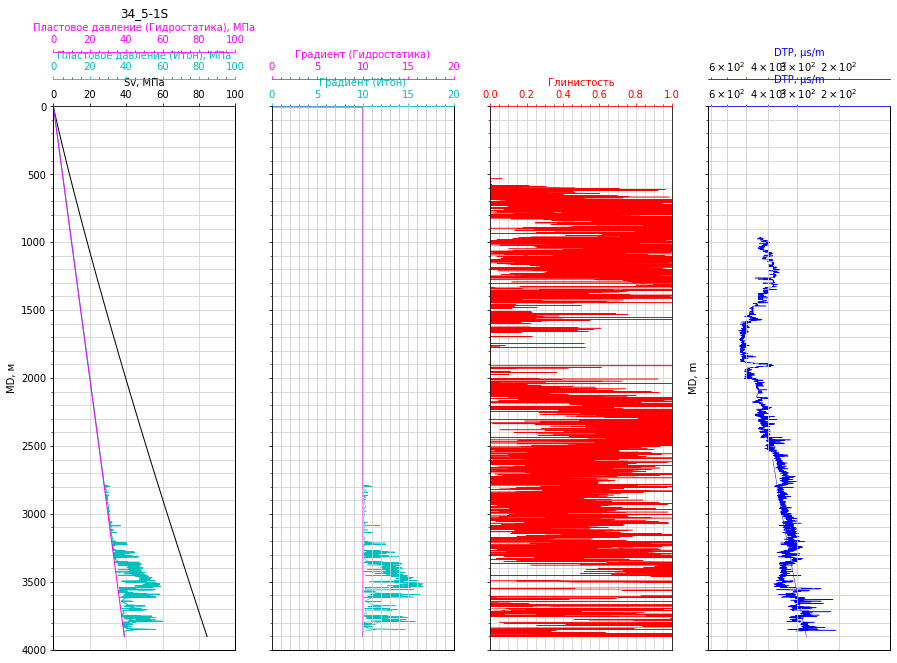

In [10]:
# Построение профилей вертикального напряжения, пластового давления и объёмной плотности
fig, axes = plt.subplots(figsize=(15,10))
#ax1.set_ylabel('MD, м')
        
ax1 = plt.subplot2grid((1,4), (0,0), rowspan=1, colspan=1)
ax2 = ax1.twiny()
ax3 = ax1.twiny()
ax4 = plt.subplot2grid((1,4), (0,1), rowspan=1, colspan=1, sharey = ax1)
ax5 = ax4.twiny()
ax6 = plt.subplot2grid((1,4), (0,2), rowspan=1, colspan=1, sharey = ax1)
ax7 = plt.subplot2grid((1,4), (0,3), rowspan=1, colspan=1, sharey = ax1)
ax8 = ax7.twiny()

ax1_color = 'black'
ax2_color = 'c'
ax3_color = 'magenta'
ax4_color = ax2_color
ax5_color = ax3_color
ax6_color = 'red'
ax7_color = 'blue'
ax8_color = ax7_color

# Вертикальное напряжение
ax1.plot(df['Overburden'], df['MD'], color=ax1_color, lw=1)
ax1.set_xlim(0, 100)
ax1.set_xlabel('Sv, МПа')
ax1.xaxis.label.set_color(ax1_color)
ax1.spines['top'].set_position(('axes', 1.00))
ax1.tick_params(axis='x', colors=ax1_color)
ax1.spines['top'].set_edgecolor(ax1_color)
ax1.set_ylim(4000, 0)
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set_title('34_5-1S')
ax1.set(ylabel='MD, м')
ax1.label_outer()

# Пластовое давление
ax2.plot(df['Eaton'], df['MD'], color=ax2_color, lw=1)
ax2.set_xlim(0, 100)
ax2.set_xlabel('Пластовое давление (Итон), МПа')
ax2.xaxis.label.set_color(ax2_color)
ax2.spines['top'].set_position(('axes', 1.05))
ax2.tick_params(axis='x', colors=ax2_color)
ax2.spines['top'].set_edgecolor(ax2_color)
ax2.minorticks_on()
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')
ax2.set_ylim(4000, 0)

# Пластовое давление
ax3.plot(df['Hydrostatic'], df['MD'], color=ax3_color, lw=1)
ax3.set_xlim(0, 100)
ax3.set_xlabel('Пластовое давление (Гидростатика), МПа')
ax3.xaxis.label.set_color(ax3_color)
ax3.spines['top'].set_position(('axes', 1.1))
ax3.tick_params(axis='x', colors=ax3_color)
ax3.spines['top'].set_edgecolor(ax3_color)
ax3.minorticks_on()
ax3.xaxis.set_ticks_position('top')
ax3.xaxis.set_label_position('top')
ax3.set_ylim(4000, 0)

# Градиенты
ax4.plot(df['Eaton Gradient'], df['MD'], color=ax4_color, lw=0.5)
ax4.set_xlim(0, 20)
ax4.set_xlabel('Градиент (Итон)')
ax4.xaxis.label.set_color(ax4_color)
ax4.spines['top'].set_position(('axes', 1.00))
ax4.tick_params(axis='x', colors=ax4_color)
ax4.spines['top'].set_edgecolor(ax4_color)
ax4.grid(which='both', color='lightgrey', linestyle='-')
ax4.minorticks_on()
ax4.xaxis.set_ticks_position('top')
ax4.xaxis.set_label_position('top')
ax4.set_ylim(4000, 0)
plt.setp(ax4.get_yticklabels(), visible=False)


ax5.plot(df['Hydrostatic Gradient'], df['MD'], color=ax5_color, lw=0.5)
ax5.set_xlim(0, 20)
ax5.set_xlabel('Градиент (Гидростатика)')
ax5.xaxis.label.set_color(ax5_color)
ax5.spines['top'].set_position(('axes', 1.05))
ax5.tick_params(axis='x', colors=ax5_color)
ax5.spines['top'].set_edgecolor(ax5_color)
ax5.grid(which='both', color='lightgrey', linestyle='-')
ax5.minorticks_on()
ax5.xaxis.set_ticks_position('top')
ax5.xaxis.set_label_position('top')
ax5.set_ylim(4000, 0)
plt.setp(ax5.get_yticklabels(), visible=False)

# Глинистость
ax6.plot(df['VSH'], df['MD'], color=ax6_color, lw=0.5)
ax6.set_xlim(0, 1)
ax6.set_xlabel('Глинистость')
ax6.xaxis.label.set_color(ax6_color)
ax6.spines['top'].set_position(('axes', 1.00))
ax6.tick_params(axis='x', colors=ax6_color)
ax6.spines['top'].set_edgecolor(ax6_color)
ax6.grid(which='both', color='lightgrey', linestyle='-')
ax6.minorticks_on()
ax6.xaxis.set_ticks_position('top')
ax6.xaxis.set_label_position('top')
ax6.set_ylim(4000, 0)
plt.setp(ax6.get_yticklabels(), visible=False)

# DTC и DTC Trend
ax7.plot(df['DTC'], df['MD'], color=ax7_color, lw=0.5)
ax7.set_xlim(720, 120)
ax7.set_xlabel('DTP, µs/m')
ax7.set_xscale('log')
ax7.set_ylabel('MD, m')
ax7.xaxis.label.set_color(ax7_color)
ax7.spines['top'].set_position(('axes', 1.00))
ax7.tick_params(axis='x', colors=ax7_color)
ax7.spines['top'].set_edgecolor(ax7_color)
ax7.grid(which='both', color='lightgrey', linestyle='-')
ax7.xaxis.set_ticks_position('top')
ax7.xaxis.set_label_position('top')
ax7.set_ylim(4000, 0)
plt.setp(ax7.get_yticklabels(), visible=False)


ax8.plot(df['DTC Trend'], df['MD'], color=ax8_color, lw=0.5)
ax8.set_xlim(720, 120)
ax8.set_xlabel('DTP, µs/m')
ax8.set_ylabel('MD, m')
ax8.set_xscale('log')
ax8.xaxis.label.set_color(ax8_color)
ax8.spines['top'].set_position(('axes', 1.05))
ax8.tick_params(axis='x', colors=ax8_color)
ax8.spines['top'].set_edgecolor(ax8_color)
ax8.grid(which='both', color='lightgrey', linestyle='-')
ax8.xaxis.set_ticks_position('top')
ax8.xaxis.set_label_position('top')
ax8.set_ylim(4000, 0)
plt.setp(ax8.get_yticklabels(), visible=False)

plt.show()

## Вертикальное напряжение с иными параметрами кривой. Отношение найденной величины к величине вертикального напряжения с прежними настройками на глубине 3000 м MD

In [11]:
surface = 1
air_gap = 6
a_tvd = 2000
b_tvd = 3700
a_rho = 2
b_rho = 2.5

old_overburden = df['Overburden'].copy()
old_rhob_extrapolated = df['RHOB_extrapolated'].copy()

high_overburden = df.loc[df['MD'] == 3000, 'Overburden'].values[0]

df['Overburden_low'], df['RHOB_extrapolated_low'] = overburden(df)
df['Overburden'], df['RHOB_extrapolated'] = old_overburden, old_rhob_extrapolated

low_overburden = df.loc[df['MD'] == 3000, 'Overburden_low'].values[0]

ratio = low_overburden / high_overburden

print(ratio)

0.8618150110412829


## Трендовая кривая DTC с другими настройками. Новое давление по Итону. Отношение новой величины пластового давления к старой на глубине 3500 м MD

In [12]:
a_dtc_tvd = 2808
b_dtc_tvd = 3835
a_dtc = 345
b_dtc = 260

old_eaton = df['Eaton'].copy()
old_eaton_gradient = df['Eaton Gradient'].copy()
old_dtc_trend = df['DTC Trend'].copy()

high_eaton = df.loc[df['MD'] == 3500, 'Eaton'].values[0]

df['DTC_Trend_low'] = dtc_trend(df)
df['Eaton_low'], df['Eaton Gradient_low'] = eaton(df)
df['DTC Trend'] = old_dtc_trend
df['Eaton'], df['Eaton Gradient'] = old_eaton, old_eaton_gradient

low_eaton = df.loc[df['MD'] == 3500, 'Eaton_low'].values[0]

ratio_eaton = low_eaton / high_eaton

print(ratio_eaton)

1.1506427706334905


/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/1816104587.py:4: MatplotlibDeprecationWarning: Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.
  ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)


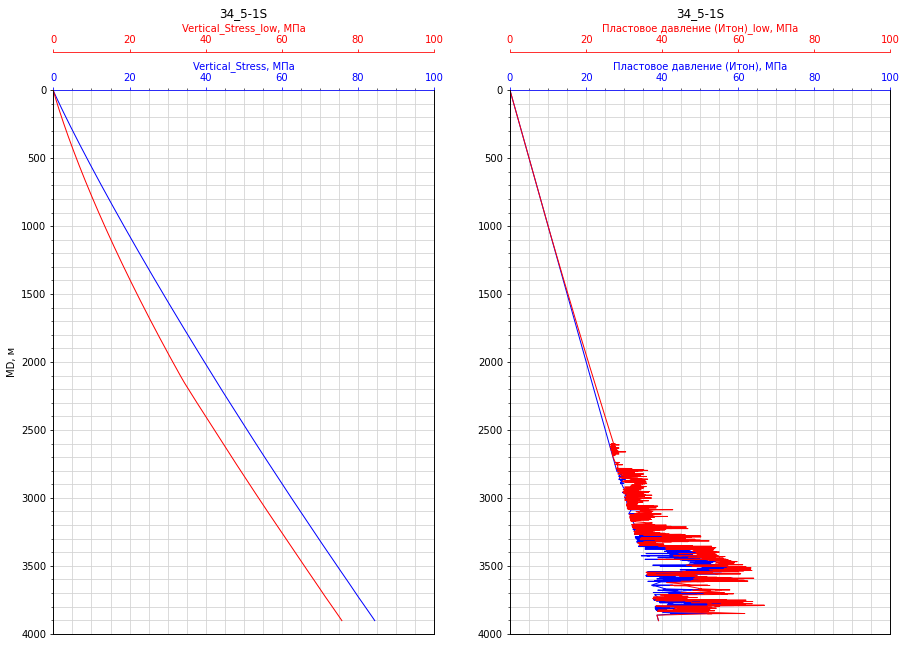

In [13]:
# Построение профилей вертикального напряжения, пластового давления и объёмной плотности
fig, axes = plt.subplots(figsize=(15,10))
        
ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax2 = ax1.twiny()
ax3 = plt.subplot2grid((1,2), (0,1), rowspan=1, colspan=1, sharey = ax1)
ax4 = ax3.twiny()

ax1_color = 'blue'
ax2_color = 'red'

# Вертикальное напряжение с первоначальными настройками (старое)
ax1.plot(old_overburden, df['MD'], color=ax1_color, lw=1)
ax1.set_xlim(0, 100)
ax1.set_xlabel('Vertical_Stress, МПа')
ax1.xaxis.label.set_color(ax1_color)
ax1.spines['top'].set_position(('axes', 1.00))
ax1.tick_params(axis='x', colors=ax1_color)
ax1.spines['top'].set_edgecolor(ax1_color)
ax1.set_ylim(4000, 0)
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.minorticks_on()
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set_title('34_5-1S')
ax1.set(ylabel='MD, м')
ax1.label_outer()

# Вертикальное напряжение с новыми настройками (новое)
ax2.plot(df['Overburden_low'], df['MD'], color=ax2_color, lw=1)
ax2.set_xlim(0, 100)
ax2.set_xlabel('Vertical_Stress_low, МПа')
ax2.xaxis.label.set_color('r')
ax2.spines['top'].set_position(('axes', 1.07))
ax2.tick_params(axis='x', colors=ax2_color)
ax2.spines['top'].set_edgecolor(ax2_color)
ax2.set_ylim(4000, 0)

# Пластовое давление с первоначальными настройками (старое)
ax3.plot(old_eaton, df['MD'], color=ax1_color, lw=1)
ax3.set_xlim(0, 100)
ax3.set_xlabel('Пластовое давление (Итон), МПа')
ax3.xaxis.label.set_color(ax1_color)
ax3.spines['top'].set_position(('axes', 1.00))
ax3.tick_params(axis='x', colors=ax1_color)
ax3.spines['top'].set_edgecolor(ax1_color)
ax3.grid(which='both', color='lightgrey', linestyle='-')
ax3.minorticks_on()
ax3.xaxis.set_ticks_position('top')
ax3.xaxis.set_label_position('top')
ax3.set_title('34_5-1S')
ax3.set_ylim(4000, 0)

# Пластовое давление с новыми настройками (новое)
ax4.plot(df['Eaton_low'], df['MD'], color=ax2_color, lw=1)
ax4.set_xlim(0, 100)
ax4.set_xlabel('Пластовое давление (Итон)_low, МПа')
ax4.xaxis.label.set_color(ax2_color)
ax4.spines['top'].set_position(('axes', 1.07))
ax4.tick_params(axis='x', colors=ax2_color)
ax4.spines['top'].set_edgecolor(ax2_color)
ax4.set_ylim(4000, 0)

plt.show()

# (2) Расчёт динамических и статических упругих свойств

In [14]:
import plotly.express as px
import plotly.offline as pyo
import plotly.graph_objects as go
pyo.init_notebook_mode()

## Расчёт профилей динамических модулей на основе ГИС

In [15]:
# Расчёт динамических модулей упругости
df['E_dyn'] = nan
df['PR_dyn'] = nan

def dynamic_moduli(
    df: pd.DataFrame,
    rhob: str,
    dtc: str,
    dts: str,
    edyn: str,
    prdyn: str
) -> pd.DataFrame:
    for i, row in df.iterrows():
        if not isnan(df.at[i, dtc]) and not isnan(df.at[i, 'DTS']):
            density = 10 ** 3 * df.at[i, rhob]  # kg/m3
            v_p = 10 ** 6 / df.at[i, dtc]  # m/s
            v_s = 10 ** 6 / df.at[i, dts]  # m/s
            g = density * v_s ** 2
            k = density * v_p ** 2 - 4 / 3 * g
            df.at[i, edyn] = 9 * k * g / (3 * k + g) / 10 ** 9  # GPa
            df.at[i, prdyn] = (3 * k - 2 * g) / 2 / (3 * k + g)
    return df

df = dynamic_moduli(df, 'RHOB', 'DTC', 'DTS', 'E_dyn', 'PR_dyn')

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/2425382187.py:4: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/2425382187.py:5: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



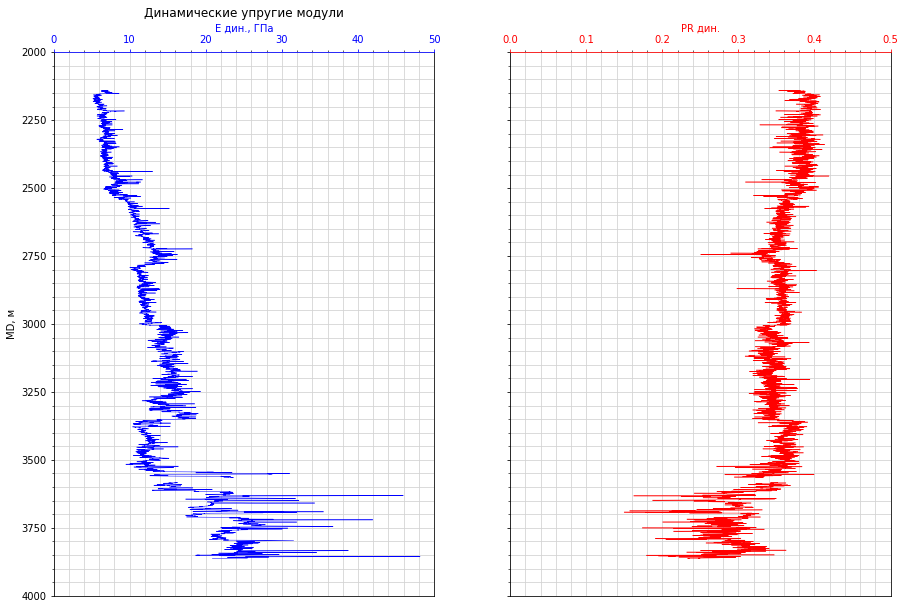

In [16]:
# Построение профилей динамических модулей упругости
fig, axes = plt.subplots(1, 2, figsize=(15,10))

ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax2 = plt.subplot2grid((1,2), (0,1), rowspan=1, colspan=1, sharey = ax1)

#ax1_color = '#00FF00'
ax1_color = 'blue'
#ax2_color = '#AAAAAA'
ax2_color = 'red'

# Динамический модуль Юнга
ax1.plot(df['E_dyn'], df['MD'], color=ax1_color, lw=0.5)
ax1.set_xlim(0, 50)
ax1.set_xlabel('E дин., ГПа')
ax1.xaxis.label.set_color(ax1_color)
ax1.spines['top'].set_position(('axes', 1.00))
ax1.tick_params(axis='x', colors=ax1_color)
ax1.spines['top'].set_edgecolor(ax1_color)
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.minorticks_on()
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set_ylim(4500, 0)
ax1.set_title('Динамические упругие модули')
ax1.set(ylabel='MD, м')
ax1.label_outer()

# Динамический коэффициент Пуассона
ax2.plot(df['PR_dyn'], df['MD'], color=ax2_color, lw=0.5)
ax2.set_xlim(0, 0.5)
ax2.set_xlabel('PR дин.')
ax2.xaxis.label.set_color(ax2_color)
ax2.spines['top'].set_position(('axes', 1.00))
ax2.tick_params(axis='x', colors=ax2_color)
ax2.spines['top'].set_edgecolor(ax2_color)
plt.setp(ax2.get_yticklabels(), visible=False)
ax2.grid(which='both', color='lightgrey', linestyle='-')
ax2.minorticks_on()
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')
ax2.set_ylim(4000, 2000)

plt.show()

## Чтение файла с керновыми данными

In [17]:
lab_df = pd.read_csv('Core_data.csv', sep=';')
lab_df

,MD,DTS_core,DTC_core,RHOB_core,E_sta_core,PR_sta_core
0,0.0,NaN,NaN,NaN,NaN,NaN
1,0.1,NaN,NaN,NaN,NaN,NaN
2,0.2,NaN,NaN,NaN,NaN,NaN
3,0.3,NaN,NaN,NaN,NaN,NaN
4,0.4,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...
39027,3902.7,NaN,NaN,NaN,NaN,NaN
39028,3902.8,NaN,NaN,NaN,NaN,NaN
39029,3902.9,NaN,NaN,NaN,NaN,NaN
39030,3903.0,NaN,NaN,NaN,NaN,NaN


In [18]:
# Задание интервалов
intervals = [2141, 2523, 2773, 3000, 3350, 3862]

df['Interval'] = nan
# Формирование цикла для заполнения колонки Interval значениями зон
for i in range(len(intervals) - 1):
    #Метод format позволяет менять строку Zone. Вместо {} подставляется значение i+1 (i считатется с 0)
    df.loc[(df['MD'] >= intervals[i]) & (df['MD'] <= intervals[i+1]), 'Interval'] = 'Zone{}'.format(i+1)

## Функция для отбора образцов

In [19]:
df['E_sta_core'] = nan
df['PR_sta_core'] = nan
df['DTS_core'] = nan
df['DTC_core'] = nan
df['RHOB_core'] = nan
# На вход подаётся тип теста: 'UCS', 'MTCS', 'TCS', 'BRAZ' обязательно в кавычках.
# depth - глубина отбора
def lab_moduli(test, depth):
    df.loc[df['MD'] == depth, 'DTC_core'] = lab_df.loc[lab_df['MD'] == depth, 'DTC_core'].values[0]
    df.loc[lab_df['MD'] == depth, 'DTS_core'] = lab_df.loc[lab_df['MD'] == depth, 'DTS_core'].values[0]
    df.loc[lab_df['MD'] == depth, 'RHOB_core'] = lab_df.loc[lab_df['MD'] == depth, 'RHOB_core'].values[0]
    df.loc[lab_df['MD'] == depth, 'PR_sta_core'] = lab_df.loc[lab_df['MD'] == depth, 'PR_sta_core'].values[0]
    if test == 'MTCS':
        df.loc[lab_df['MD'] == depth, 'E_sta_core'] = lab_df.loc[lab_df['MD'] == depth, 'E_sta_core'].values[0]
    elif test == 'TCS':
        df.loc[lab_df['MD'] == depth, 'E_sta_core'] = lab_df.loc[lab_df['MD'] == depth, 'E_sta_core'].values[0]*0.9
    elif test == 'UCS':
        df.loc[lab_df['MD'] == depth, 'E_sta_core'] = lab_df.loc[lab_df['MD'] == depth, 'E_sta_core'].values[0]*0.8
    elif test == 'BRAZ':
        df.loc[lab_df['MD'] == depth, 'E_sta_core'] = lab_df.loc[lab_df['MD'] == depth, 'E_sta_core'].values[0]*0.8
    else:
        print('Смените тип теста')
    return df

## Отбор образцов

In [20]:
# интервалы: [2141, 2523, 2773, 3000, 3350, 3862]

def depth_for_interval(intervals, ind, method):
    if method == 'UCS+3TCS+BRAZ':
        return int(intervals[ind] + (intervals[ind + 1] - intervals[ind]) / 4)
    elif method == 'UCS+3MTCS+BRAZ':
        return int(intervals[ind] + 3 * (intervals[ind + 1] - intervals[ind]) / 4)

step = 0.1
depths_of_samples = []
for i, depth in enumerate(intervals[:-1]):
    # берём 4 образца с близких друг к другу глубин
    for j in range(5):
        depths_of_samples.append(
        depth_for_interval(intervals, i, 'UCS+3TCS+BRAZ') + j * step
    )
    # берём 4 образца с близких друг к другу глубин
    for j in range(5):
        depths_of_samples.append(
        depth_for_interval(intervals, i, 'UCS+3MTCS+BRAZ') + j * step
    )

# первый интервал
df = lab_moduli('UCS', depths_of_samples[0])
df = lab_moduli('TCS', depths_of_samples[1])
df = lab_moduli('TCS', depths_of_samples[2])
df = lab_moduli('TCS', depths_of_samples[3])
df = lab_moduli('BRAZ', depths_of_samples[4])

df = lab_moduli('UCS', depths_of_samples[5])
df = lab_moduli('MTCS', depths_of_samples[6])
df = lab_moduli('MTCS', depths_of_samples[7])
df = lab_moduli('MTCS', depths_of_samples[8])
df = lab_moduli('BRAZ', depths_of_samples[9])


# второй интервал
df = lab_moduli('UCS', depths_of_samples[10])
df = lab_moduli('TCS', depths_of_samples[11])
df = lab_moduli('TCS', depths_of_samples[12])
df = lab_moduli('TCS', depths_of_samples[13])
df = lab_moduli('BRAZ', depths_of_samples[14])

df = lab_moduli('UCS', depths_of_samples[15])
df = lab_moduli('MTCS', depths_of_samples[16])
df = lab_moduli('MTCS', depths_of_samples[17])
df = lab_moduli('MTCS', depths_of_samples[18])
df = lab_moduli('BRAZ', depths_of_samples[19])


# третий интервал
df = lab_moduli('UCS', depths_of_samples[20])
df = lab_moduli('TCS', depths_of_samples[21])
df = lab_moduli('TCS', depths_of_samples[22])
df = lab_moduli('TCS', depths_of_samples[23])
df = lab_moduli('BRAZ', depths_of_samples[24])

df = lab_moduli('UCS', depths_of_samples[25])
df = lab_moduli('MTCS', depths_of_samples[26])
df = lab_moduli('MTCS', depths_of_samples[27])
df = lab_moduli('MTCS', depths_of_samples[28])
df = lab_moduli('BRAZ', depths_of_samples[29])


# четвёртый интервал
df = lab_moduli('UCS', depths_of_samples[30])
df = lab_moduli('TCS', depths_of_samples[31])
df = lab_moduli('TCS', depths_of_samples[32])
df = lab_moduli('TCS', depths_of_samples[33])
df = lab_moduli('BRAZ', depths_of_samples[34])

df = lab_moduli('UCS', depths_of_samples[35])
df = lab_moduli('MTCS', depths_of_samples[36])
df = lab_moduli('MTCS', depths_of_samples[37])
df = lab_moduli('MTCS', depths_of_samples[38])
df = lab_moduli('BRAZ', depths_of_samples[39])


# пятый интервал
df = lab_moduli('UCS', depths_of_samples[40])
df = lab_moduli('TCS', depths_of_samples[41])
df = lab_moduli('TCS', depths_of_samples[42])
df = lab_moduli('TCS', depths_of_samples[43])
df = lab_moduli('BRAZ', depths_of_samples[44])

df = lab_moduli('UCS', depths_of_samples[45])
df = lab_moduli('MTCS', depths_of_samples[46])
df = lab_moduli('MTCS', depths_of_samples[47])
df = lab_moduli('MTCS', depths_of_samples[48])
df = lab_moduli('BRAZ', depths_of_samples[49])

print('Глубины отбора образцов:')
print(depths_of_samples)

Глубины отбора образцов:
[2236.0, 2236.1, 2236.2, 2236.3, 2236.4, 2427.0, 2427.1, 2427.2, 2427.3, 2427.4, 2585.0, 2585.1, 2585.2, 2585.3, 2585.4, 2710.0, 2710.1, 2710.2, 2710.3, 2710.4, 2829.0, 2829.1, 2829.2, 2829.3, 2829.4, 2943.0, 2943.1, 2943.2, 2943.3, 2943.4, 3087.0, 3087.1, 3087.2, 3087.3, 3087.4, 3262.0, 3262.1, 3262.2, 3262.3, 3262.4, 3478.0, 3478.1, 3478.2, 3478.3, 3478.4, 3734.0, 3734.1, 3734.2, 3734.3, 3734.4]


## Коррекция и построение графика DTC_core

In [21]:
df['DTC_core'] = df['DTC_core'] + 10

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/840024331.py:4: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



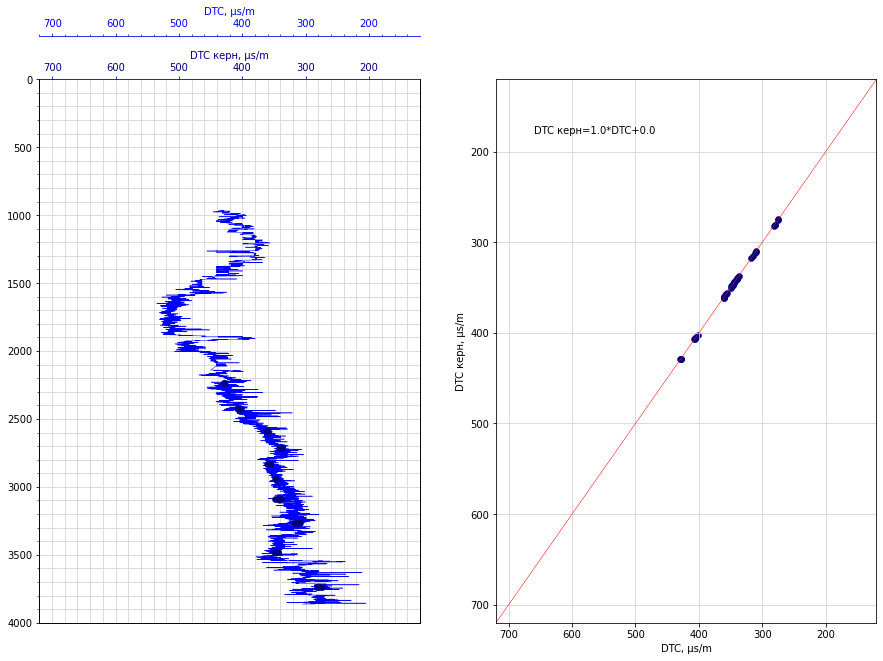

In [22]:
fig, axes = plt.subplots(figsize=(15,10))
#ax1.set_ylabel('MD, м')
        
ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax2 = ax1.twiny()
ax3 = plt.subplot2grid((1,2), (0,1), rowspan=1, colspan=1)

# DTC
ax1.plot(df['DTC'], df['MD'], color='blue', lw=0.5)
ax1.set_xlim(720, 120)
ax1.set_xlabel('DTC, µs/m')
ax1.xaxis.label.set_color('blue')
ax1.spines['top'].set_position(('axes', 1.08))
ax1.tick_params(axis='x', colors='blue')
ax1.spines['top'].set_edgecolor('blue')
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.minorticks_on()
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set_ylim(4000, 0)

# DTC core
ax2.scatter(df['DTC_core'], df['MD'], color='navy', lw=0.5)
ax2.set_xlim(720, 120)
ax2.set_xlabel('DTC керн, µs/m')
ax2.set_ylabel('MD, m')
ax2.xaxis.label.set_color('navy')
ax2.spines['top'].set_position(('axes', 1.00))
ax2.tick_params(axis='x', colors='navy')
ax2.spines['top'].set_edgecolor('navy')
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')
ax2.set_ylim(4000, 0)


varx = df['DTC'].values
vary = df['DTC_core'].values
mask = ~np.isnan(varx) & ~np.isnan(vary)
res = stats.linregress(varx[mask], vary[mask])

ax3.scatter(df['DTC_core'], df['DTC'], color='navy', lw=0.5)
ax3.set_xlabel('DTC, µs/m')
ax3.set_ylabel('DTC керн, µs/m')
ax3.plot(np.linspace(0,1000,10),np.linspace(0,1000,10), color='red', lw=0.5)
ax3.set_xlim(720, 120)
ax3.set_ylim(720, 120)
ax3.grid(which='both', color='lightgrey', linestyle='-')
ax3.annotate('DTC керн={0}*DTC+{1}'.format(round(res.slope,1), round(res.intercept,1)),
            xy=(0,0), xycoords='axes fraction', xytext=(0.1,0.9))

plt.show()
# Посмотреть полный список цветов можно тут: https://matplotlib.org/stable/gallery/color/named_colors.html

## Коррекция и построение графика DTS_core

In [23]:
df['DTS_core'] = df['DTS_core'] + 20

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/840931471.py:4: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



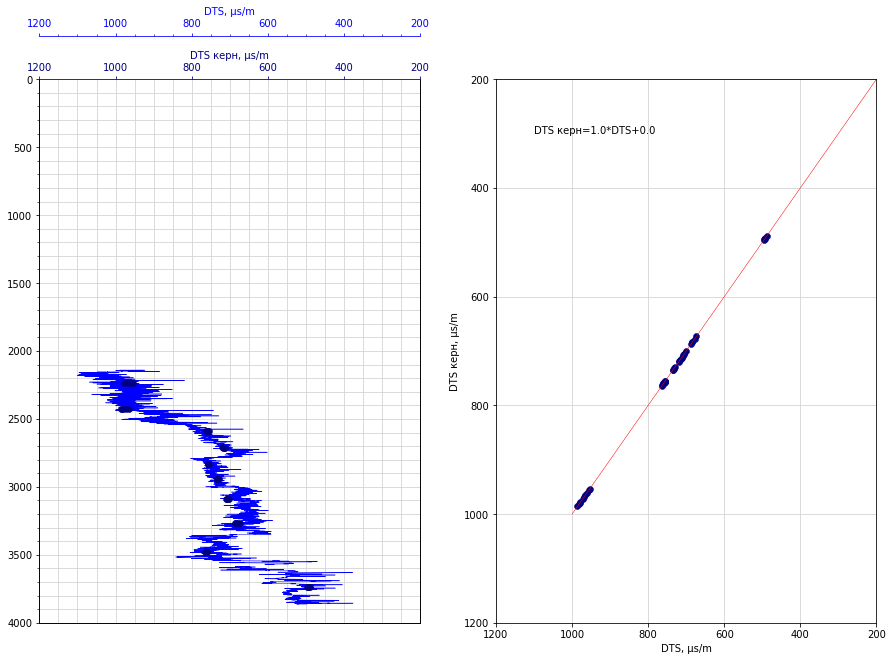

In [24]:
fig,axes = plt.subplots(figsize=(15,10))
#ax1.set_ylabel('MD, м')
        
ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax2 = ax1.twiny()
ax3 = plt.subplot2grid((1,2), (0,1), rowspan=1, colspan=1)

# DTS
ax1.plot(df['DTS'], df['MD'], color='blue', lw=0.5)
ax1.set_xlim(1200, 200)
ax1.set_xlabel('DTS, µs/m')
ax1.xaxis.label.set_color('blue')
ax1.spines['top'].set_position(('axes', 1.08))
ax1.tick_params(axis='x', colors='blue')
ax1.spines['top'].set_edgecolor('blue')
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.minorticks_on()
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set_ylim(4000, 0)

# DTS core
ax2.scatter(df['DTS_core'], df['MD'], color='navy', lw=0.5)
ax2.set_xlim(1200, 200)
ax2.set_xlabel('DTS керн, µs/m')
ax2.set_ylabel('MD, m')
ax2.xaxis.label.set_color('navy')
ax2.spines['top'].set_position(('axes', 1.00))
ax2.tick_params(axis='x', colors='navy')
ax2.spines['top'].set_edgecolor('navy')
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')
ax2.set_ylim(4000, 0)


varx = df['DTS'].values
vary = df['DTS_core'].values
mask = ~np.isnan(varx) & ~np.isnan(vary)
res = stats.linregress(varx[mask], vary[mask])

ax3.scatter(df['DTS_core'], df['DTS'], color='navy', lw=0.5)
ax3.set_xlabel('DTS, µs/m')
ax3.set_ylabel('DTS керн, µs/m')
ax3.plot(np.linspace(0,1000,10),np.linspace(0,1000,10), color='red', lw=0.5)
ax3.set_xlim(1200, 200)
ax3.set_ylim(1200, 200)
ax3.grid(which='both', color='lightgrey', linestyle='-')
ax3.annotate('DTS керн={0}*DTS+{1}'.format(round(res.slope,1), round(res.intercept,1)),
            xy=(0,0), xycoords='axes fraction', xytext=(0.1,0.9))

plt.show()

## Коррекция и построение графика RHOB_core

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/643035898.py:4: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



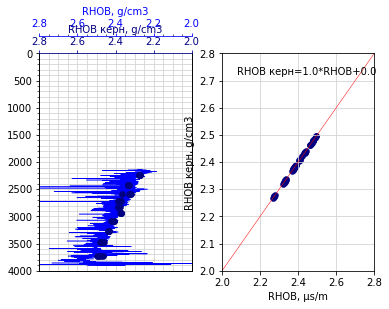

In [25]:
fig,axes = plt.subplots()
#ax1.set_ylabel('MD, м')
        
ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax2 = ax1.twiny()
ax3 = plt.subplot2grid((1,2), (0,1), rowspan=1, colspan=1)

# DTS
ax1.plot(df['RHOB'], df['MD'], color='blue', lw=0.5)
ax1.set_xlim(2.8, 2)
ax1.set_xlabel('RHOB, g/cm3')
ax1.xaxis.label.set_color('blue')
ax1.spines['top'].set_position(('axes', 1.08))
ax1.tick_params(axis='x', colors='blue')
ax1.spines['top'].set_edgecolor('blue')
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.minorticks_on()
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set_ylim(4000, 0)

# DTS core
ax2.scatter(df['RHOB_core'], df['MD'], color='navy', lw=0.5)
ax2.set_xlim(2.8, 2)
ax2.set_xlabel('RHOB керн, g/cm3')
ax2.set_ylabel('MD, m')
ax2.xaxis.label.set_color('navy')
ax2.spines['top'].set_position(('axes', 1.00))
ax2.tick_params(axis='x', colors='navy')
ax2.spines['top'].set_edgecolor('navy')
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')
ax2.set_ylim(4000, 0)


varx = df['RHOB'].values
vary = df['RHOB_core'].values
mask = ~np.isnan(varx) & ~np.isnan(vary)
res = stats.linregress(varx[mask], vary[mask])

ax3.scatter(df['RHOB_core'], df['RHOB'], color='navy', lw=0.5)
ax3.set_xlabel('RHOB, µs/m')
ax3.set_ylabel('RHOB керн, g/cm3')
ax3.plot(np.linspace(0,1000,10),np.linspace(0,1000,10), color='red', lw=0.5)
ax3.set_xlim(2, 2.8)
ax3.set_ylim(2, 2.8)
ax3.grid(which='both', color='lightgrey', linestyle='-')
ax3.annotate('RHOB керн={0}*RHOB+{1}'.format(round(res.slope,1), round(res.intercept,1)),
            xy=(0,0), xycoords='axes fraction', xytext=(0.1,0.9))

plt.show()

## Расчёт динамических упругих модулей на керне

In [26]:
df = dynamic_moduli(df, 'RHOB_core', 'DTC_core', 'DTS_core', 'E_dyn_core', 'PR_dyn_core')

## Первичное построение графиков динамика-статика на керне

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/4026921010.py:3: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



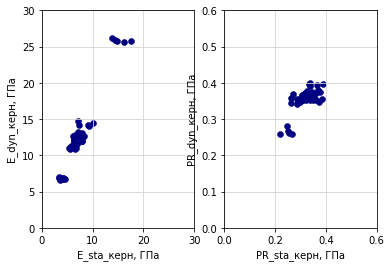

In [27]:
fig, axes = plt.subplots()
 
ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax1.scatter(df['E_sta_core'], df['E_dyn_core'], color='navy', lw=0.5)
ax1.set_xlabel('E_sta_керн, ГПа')
ax1.set_ylabel('E_dyn_керн, ГПа')
ax1.set_xlim(0, 30)
ax1.set_ylim(0, 30)
ax1.grid(which='both', color='lightgrey', linestyle='-')

ax2 = plt.subplot2grid((1,2), (0,1), rowspan=1, colspan=1)
ax2.scatter(df['PR_sta_core'], df['PR_dyn_core'], color='navy', lw=0.5)
ax2.set_xlabel('PR_sta_керн, ГПа')
ax2.set_ylabel('PR_dyn_керн, ГПа')
ax2.set_xlim(0, 0.6)
ax2.set_ylim(0, 0.6)
ax2.grid(which='both', color='lightgrey', linestyle='-')

plt.show()

## Функция для построения линейных корреляций динамика-статика

In [28]:
def static_moduli_correlation(top, bottom, dynamic, static):
    varx = df.loc[(df['MD'] >= top) & (df['MD'] <= bottom), dynamic].values
    vary = df.loc[(df['MD'] >= top) & (df['MD'] <= bottom), static].values
    mask = ~np.isnan(varx) & ~np.isnan(vary)
    result = stats.linregress(varx[mask], vary[mask])
    return result.slope, result.intercept

## Сохранение параметров регрессии для модуля Юнга в словарь e_parameters

In [29]:
e_parameters = {}

for i in range(len(intervals)-1):
    # идёт расчёт корреляций по ранее заданным зонам в листе intervals
    slope, intercept = static_moduli_correlation(intervals[i], intervals[i+1],'E_dyn_core', 'E_sta_core')
    # для каждой зоны проводится соответствие параметрам корреляции: наклон кривой и пересечение с осью ординат
    e_parameters['Zone{}'.format(i+1)] = [slope, intercept]

e_parameters

{'Zone1': [0.25062113077022874, 2.168710228802521],
 'Zone2': [0.7611547004603443, -2.368124759086786],
 'Zone3': [1.557370666346422, -11.408474847426577],
 'Zone4': [0.9187569036810509, -4.666825040918645],
 'Zone5': [0.6195123946458099, -0.659730558946972]}

## Сохранение параметров регрессии для коэффициента Пуассона в словарь pr_parameters

In [30]:
pr_parameters = {}

for i in range(len(intervals)-1):
    # идёт расчёт корреляций по ранее заданным зонам в листе intervals
    slope, intercept = static_moduli_correlation(intervals[i], intervals[i+1], 'PR_dyn_core', 'PR_sta_core')
    # для каждой зоны проводится соответствие параметрам корреляции: наклон кривой и пересечение с осью ординат
    pr_parameters['Zone{}'.format(i+1)] = [slope, intercept]

pr_parameters

{'Zone1': [-0.030183630161821497, 0.3651782624198904],
 'Zone2': [-8.439359953264363, 3.3055340927325005],
 'Zone3': [1.4185617328887095, -0.18345156591771777],
 'Zone4': [1.3339546897459806, -0.1609173306134537],
 'Zone5': [0.675482478310926, 0.06826924687134939]}

## Вычисление глобальных параметров регрессии для модуля Юнга и коэффициента Пуассона

In [31]:
e_global_slope, e_global_intercept = static_moduli_correlation(intervals[0], intervals[-1], 'E_dyn_core', 'E_sta_core')
pr_global_slope, pr_global_intercept = static_moduli_correlation(intervals[0], intervals[-1], 'PR_dyn_core', 'PR_sta_core')

## Построение графиков динамика-статика и корреляций по зонам для модуля Юнга

In [32]:
# задание массива x для построения прямой
x = np.linspace(0, 40, 100)
# Счётчик для изменения цвета графиков
i = 1
# Точечный график. На вход идёт:
#  - сам датафрейм
#  - столбцы со значениями по x и y
#  - колонка, которую нужно разделить по цвету
#  - color_discrete_sequence - параметр, который будет брать цвета из цветовой шкалы Plotly.
# можно выбрать любую другую: https://plotly.com/python/discrete-color/
fig = px.scatter(df,
     x='E_dyn_core',
     y='E_sta_core',
     color='Interval',
     color_discrete_sequence=px.colors.qualitative.Plotly)

# графики линейной корреляции задаются другим типом графиков, похожих по структуре на matplotlib
# идёт цикл по ключам (key) и значениям (value) для параметров регрессии
# mode='lines' необходимо для отображения графика в виде линии, а не точек
# name=key означает, что в легенде будет отображаться название зоны
# px.colors.qualitative.Plotly является листом, к какждом цвету которого можно обратиться через [i] и подтянуть его оттуда
for key, value in e_parameters.items():
    fig.add_trace(
        go.Scatter(
            x=x,
            y=value[0]*x+value[1],
            mode='lines',
            name=key,
            marker_color=px.colors.qualitative.Plotly[i])
    )
    i+=1

# построение глобальной корреляции
fig.add_trace(
    go.Scatter(
        x=x,
        y=e_global_slope*x+e_global_intercept,
        mode='lines',
        name='Global Correlation',
        marker_color='black',
        line=dict(dash='dash'),
    )
)

fig.show(auto_open=True)

## Построение графиков динамика-статика и корреляций по зонам для коэффициента Пуассона

In [33]:
# задание массива x для построения прямой
x = np.linspace(0.15, 0.5, 100)
# Счётчик для изменения цвета графиков
i = 1
# Точечный график. На вход идёт:
#  - сам датафрейм
#  - столбцы со значениями по x и y
#  - колонка, которую нужно разделить по цвету
#  - color_discrete_sequence - параметр, который будет брать цвета из цветовой шкалы Plotly.
# можно выбрать любую другую: https://plotly.com/python/discrete-color/
fig = px.scatter(df,
     x='PR_dyn_core',
     y='PR_sta_core',
     color='Interval',
     color_discrete_sequence=px.colors.qualitative.Plotly)

# графики линейной корреляции задаются другим типом графиков, похожих по структуре на matplotlib
# идёт цикл по ключам (key) и значениям (value) для параметров регрессии
# mode='lines' необходимо для отображения графика в виде линии, а не точек
# name=key означает, что в легенде будет отображаться название зоны
# px.colors.qualitative.Plotly является листом, к какждом цвету которого можно обратиться через [i] и подтянуть его оттуда
for key, value in pr_parameters.items():
    fig.add_trace(
        go.Scatter(
            x=x,
            y=value[0]*x+value[1],
            mode='lines',
            name=key,
            marker_color=px.colors.qualitative.Plotly[i])
    )
    i+=1

# построение глобальной корреляции
fig.add_trace(
    go.Scatter(
        x=x,
        y=pr_global_slope*x+pr_global_intercept,
        mode='lines',
        name='Global Correlation',
        marker_color='black',
        line=dict(dash='dash'),
    )
)

fig.show(auto_open=True)

## Замена отрицательных корреляций на глобальные корреляции

In [34]:
# для модулей Юнга
for key, value in e_parameters.items():
    if value[0] < 0:
        e_parameters[key] = [e_global_slope, e_global_intercept]

# для коэффициентов Пуассона
for key, value in pr_parameters.items():
    if value[0] < 0:
        pr_parameters[key] = [pr_global_slope, pr_global_intercept]

display(e_parameters)
display(pr_parameters)

{'Zone1': [0.25062113077022874, 2.168710228802521],
 'Zone2': [0.7611547004603443, -2.368124759086786],
 'Zone3': [1.557370666346422, -11.408474847426577],
 'Zone4': [0.9187569036810509, -4.666825040918645],
 'Zone5': [0.6195123946458099, -0.659730558946972]}

{'Zone1': [0.82398147167074, 0.026061776605869336],
 'Zone2': [0.82398147167074, 0.026061776605869336],
 'Zone3': [1.4185617328887095, -0.18345156591771777],
 'Zone4': [1.3339546897459806, -0.1609173306134537],
 'Zone5': [0.675482478310926, 0.06826924687134939]}

## Расчёт профилей статических свойств при помощи корреляций

In [35]:
# расчёт статических модулей упругости
# на вход подаётся переменная zones, которая может принимать значения либо True, либо False
# если она равна True, то идёт расчёт по зонам
df['E_sta_global'] = nan
df['PR_sta_global'] = nan

def static_moduli(df, zones, e_parameters, pr_parameters):
    df['E_sta'] = nan
    df['PR_sta'] = nan
    for i, row in df.iterrows():
        if not isnan(df.at[i, 'E_dyn']) and not pd.isna(df.at[i, 'Interval']):
            e_d = df.at[i, 'E_dyn']  # GPa
            pr_d = df.at[i, 'PR_dyn']
            if zones:
                e_slope = e_parameters[df.at[i,'Interval']][0]
                e_intercept = e_parameters[df.at[i,'Interval']][1]
                pr_slope = pr_parameters[df.at[i,'Interval']][0]
                pr_intercept = pr_parameters[df.at[i,'Interval']][1]
                df.at[i, 'E_sta'] = e_slope * e_d + e_intercept
                df.at[i, 'PR_sta'] = pr_slope * pr_d + pr_intercept
            else:
                df.at[i, 'E_sta_global'] = e_parameters[0] * e_d + e_parameters[1]
                df.at[i, 'PR_sta_global'] = pr_parameters[0] * pr_d + pr_parameters[1]
    return df

In [36]:
df = static_moduli(df, False, [e_global_slope, e_global_intercept], [pr_global_slope, pr_global_intercept])
df = static_moduli(df, True, e_parameters, pr_parameters)

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/1445542596.py:4: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



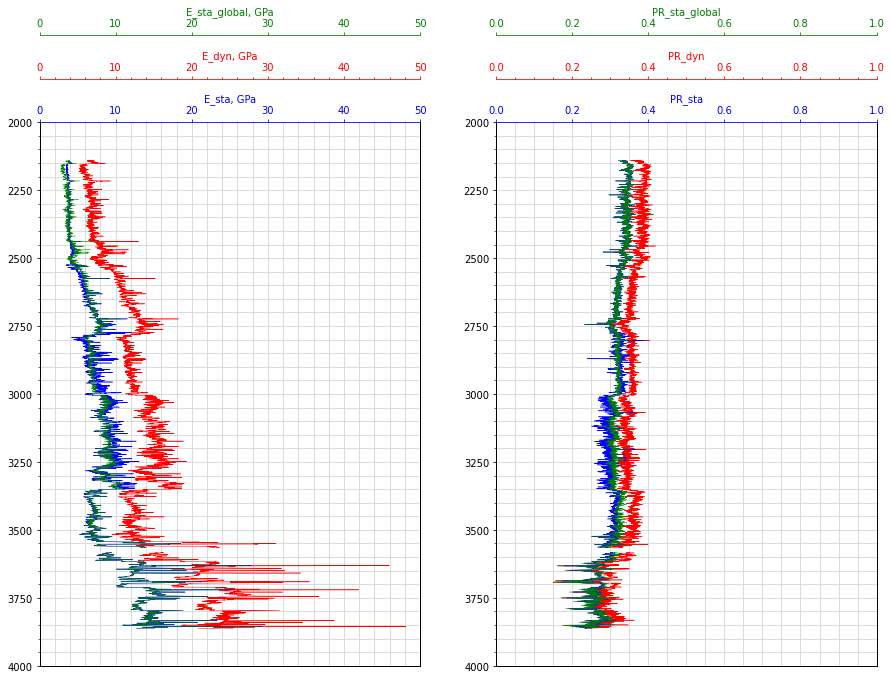

In [37]:
fig,axes = plt.subplots(figsize=(15,10))
#ax1.set_ylabel('MD, м')

ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax2 = ax1.twiny()
ax3 = ax1.twiny()

ax4 = plt.subplot2grid((1,2), (0,1), rowspan=1, colspan=1, sharey = ax1)
ax5 = ax4.twiny()
ax6 = ax4.twiny()

dyn_color = 'red'
stat_zones_color = 'blue'
stat_global_color = 'green'

# Модуль Юнга (динамический)
ax1.plot(df['E_dyn'], df['MD'], color=dyn_color, lw=0.5)
ax1.set_xlim(0, 50)
ax1.set_xlabel('E_dyn, GPa')
ax1.xaxis.label.set_color(dyn_color)
ax1.spines['top'].set_position(('axes', 1.08))
ax1.tick_params(axis='x', colors=dyn_color)
ax1.spines['top'].set_edgecolor(dyn_color)
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.minorticks_on()
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set_ylim(4000, 2000)

# Модуль Юнга (статический по корреляциям по зонам)
ax2.plot(df['E_sta'], df['MD'], color=stat_zones_color, lw=0.5)
ax2.set_xlim(0, 50)
ax2.set_xlabel('E_sta, GPa')
ax2.set_ylabel('MD, m')
ax2.xaxis.label.set_color(stat_zones_color)
ax2.spines['top'].set_position(('axes', 1.00))
ax2.tick_params(axis='x', colors=stat_zones_color)
ax2.spines['top'].set_edgecolor(stat_zones_color)
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')
ax2.set_ylim(4000, 2000)

# Модуль Юнга (статический по глобальной корреляции)
ax3.plot(df['E_sta_global'], df['MD'], color=stat_global_color, lw=0.3)
ax3.set_xlim(0, 50)
ax3.set_xlabel('E_sta_global, GPa')
ax3.set_ylabel('MD, m')
ax3.xaxis.label.set_color(stat_global_color)
ax3.spines['top'].set_position(('axes', 1.16))
ax3.tick_params(axis='x', colors=stat_global_color)
ax3.spines['top'].set_edgecolor(stat_global_color)
ax3.xaxis.set_ticks_position('top')
ax3.xaxis.set_label_position('top')
ax3.set_ylim(4000, 2000)

# Коэффициент Пуассона (динамический)
ax4.plot(df['PR_dyn'], df['MD'], color=dyn_color, lw=0.5)
ax4.set_xlim(0, 1)
ax4.set_xlabel('PR_dyn')
ax4.xaxis.label.set_color(dyn_color)
ax4.spines['top'].set_position(('axes', 1.08))
ax4.tick_params(axis='x', colors=dyn_color)
ax4.spines['top'].set_edgecolor(dyn_color)
ax4.grid(which='both', color='lightgrey', linestyle='-')
ax4.minorticks_on()
ax4.xaxis.set_ticks_position('top')
ax4.xaxis.set_label_position('top')
ax4.set_ylim(4000, 2000)

# Коэффициент Пуассона (статический по корреляциям по зонам)
ax5.plot(df['PR_sta'], df['MD'], color=stat_zones_color, lw=0.5)
ax5.set_xlim(0, 1)
ax5.set_xlabel('PR_sta')
ax5.set_ylabel('MD, m')
ax5.xaxis.label.set_color(stat_zones_color)
ax5.spines['top'].set_position(('axes', 1.00))
ax5.tick_params(axis='x', colors=stat_zones_color)
ax5.spines['top'].set_edgecolor(stat_zones_color)
ax5.xaxis.set_ticks_position('top')
ax5.xaxis.set_label_position('top')
ax5.set_ylim(4000, 2000)

# Коэффициент Пуассона (статический по глобальной корреляции)
ax6.plot(df['PR_sta_global'], df['MD'], color=stat_global_color, lw=0.3)
ax6.set_xlim(0, 1)
ax6.set_xlabel('PR_sta_global')
ax6.set_ylabel('MD, m')
ax6.xaxis.label.set_color(stat_global_color)
ax6.spines['top'].set_position(('axes', 1.16))
ax6.tick_params(axis='x', colors=stat_global_color)
ax6.spines['top'].set_edgecolor(stat_global_color)
ax6.xaxis.set_ticks_position('top')
ax6.xaxis.set_label_position('top')
ax6.set_ylim(4000, 2000)

plt.show()

# (3) Импорт прочностных свойств керна

In [38]:
# импортируем дополнительные библиотеки
import matplotlib.text as mpl_text
from openpyxl import load_workbook

# изменяем MD в файле с параметрами прочности образцов
# (считаем, что измерения проведены именно для отобранных нами образцов из интервалов intervals)
md_new = pd.DataFrame({'MD': depths_of_samples})
wb = load_workbook('Паспорта прочности.xlsx')
ws = wb['Паспорта']
for index, row in md_new.iterrows():
    cell = 'C%d' % (index + 2)
    ws[cell] = row[0]
wb.save('Паспорта прочности.xlsx')

# создаём папку для хранения паспортов прочности
if not os.path.exists('Паспорта прочности'):
    os.makedirs('Паспорта прочности')

## Построение паспортов прочности

In [39]:
for file in os.listdir(cwd):
    filename = os.fsdecode(file)
    if filename.endswith('Паспорта прочности.xlsx'):
        df_strength = pd.read_excel(filename)
        # В некоторых случаях рядом со столбцами с данными могут находиться пустые столбцы,
        # которые по какой-то причине считываются питоном. Чтобы их убрать, делаем поиск
        # по всем колонкам, в навании которых есть 
        df_strength = df_strength.loc[:,~df_strength.columns.str.contains('^Unnamed')]
        # добавляем столбцы с центром круга Мора Xc, его радиусом R, углом внутреннего трения FANG
        # и когезией COHESION
        df_strength['Xc'] = ''
        df_strength['R'] = ''
        df_strength['FANG'] = ''
        df_strength['COHESION'] = ''
        df_strength['MD'] = df_strength['MD'].round(1)

        # расcчитываем Xc и R для каждого круга Мора
        for index, row in df_strength.iterrows():
            # задаём максимальное напряжение на каждой стадии или UCS
            sigma1 = df_strength.loc[index, 'Max pressure']
            # задаём обжимное давление
            sigma3 = df_strength.loc[index, 'Confining pressure']
            # для бразильских тестов центр круга Мора будет в отрицательной части оси
            if df_strength.loc[index, 'Type'] == 'BRAZ':
                df_strength.loc[index, 'Xc'] = -(sigma1+sigma3)/2
                df_strength.loc[index, 'R'] = (sigma1-sigma3)/2
            else:
                df_strength.loc[index, 'Xc'] = (sigma1+sigma3)/2
                df_strength.loc[index, 'R'] = (sigma1-sigma3)/2

        # по какой-то причине некоторые столбцы имеют тип <object> вместо <float64>, что не даёт проводить вычисления
        # здесь мы конвертируем столбцы Xc и R в float64
        df_strength['Xc'] = df_strength['Xc'].astype(np.float64)
        df_strength['R'] = df_strength['R'].astype(np.float64)

        # функция groupby() используется для разделения датафрейма на группы по какому-либо столбцу.
        # мы возьмём столбцец N, который содержит номера паспортов прочности
        df_strength_grouped = df_strength.groupby('N')
        
        # данный цикл позволяет провести итерации по группам отдельно
        # переменная name содержит в себе имя группы или паспорта прочности: 1, 2, 3 и т.д.
        # переменная group содержит в себе часть датафрейма df_strength_grouped со всей информацией по каждой группе
        for name, group in df_strength_grouped:
            # создаём пространство для построения графика fig и оси ax
            fig, ax = plt.subplots()
            # одинаковый шаг по осям, чтобы круг Мора выглядел кругом, а не эллипсом
            ax.axis('square')
            # включение сетки
            ax.grid(True)
            # обозначаем пределы видимости графиков
            xmax = group['Xc'].max()+group['R'].max()
            ymax = 100
            ymax = group['R'].max()*1.3
            xmin = group[group['Type'] == 'BRAZ']['Max pressure'].max() if 'BRAZ' in group['Type'].values else 0
            ax.axis([-xmin, xmax, 0, ymax])
            # задаём название графика
            ax.set_title('ПП '+str(name)+', MD= '+str(round(group['MD'].mean(),1))+' м')
            # задаём названия осей
            ax.set_ylabel('Касательное напряжение, MPa')
            ax.set_xlabel('Нормальное напряжение, MPa')

            # задаём массив с цветами, чтобы круги Мора были разного цвета
            cmap = plt.get_cmap('Dark2')
            # удобный приём для создания списка, который называется list comprehension
            colors = [cmap(i) for i in range(len(cmap.colors))]
            # счётчик, который связан с номером теста и цветом круга Мора
            id = 0
            # данные массивы необходимы для заполнения легенды графика
            circles = []
            labels = []
            # Для каждого паспорта прочности определяется номер индекса (самого первого столбца),
            # соответствующий кругу с UCS и кругу с наибольшим радиусом.
            # Для этих кругов будет определяться угол внутрненнего трения.
            if group['Type'].str.contains('UCS').any() and group['Type'].str.contains('TCS').any():
                for index, row in group.iterrows():
                    if group.loc[index, 'Type'] == 'UCS':
                        min_idx = index
                # max_idx определяется для круга Мора с наибольшим радиусом
                max_idx = group['R'].where(group['Type'] != 'UCS').idxmax()
            else:
                for index, row in group.iterrows():
                    # данный цикл запускается, если в группе нет ни UCS, ни TCS одновременно (на всякий случай)
                    # в таком случае касательная строится между одним из кругов Мора для TCS, UCS, MTCS и BRAZ
                    if group.loc[index, 'Type'] == 'BRAZ':
                        min_idx = index
                max_idx = group['R'].where(group['Type'] != 'BRAZ').idxmax()

            # отбираем центра и радиусов кругов Мора для построения касательной

            x1 = group.loc[min_idx, 'Xc']
            x2 = group.loc[max_idx, 'Xc']
            r1 = group.loc[min_idx, 'R']
            r2 = group.loc[max_idx, 'R']

            # расчёт угла внутреннего трения
            fang = np.arcsin((r2-r1)/abs(x2-x1))
            gamma = 0
            #alpha = 2 beta 
            alpha = gamma-fang

            # точка, которой прямая касается самого левого круга Мора
            x3 = x1 + r1*np.sin(alpha)
            y3 = 0 + r1*np.cos(alpha)

            # расчёт когезии
            cohesion = y3-np.tan(fang)*x3

            # построение прямой разрушения
            x = np.linspace(-xmin, xmax)
            # без запятой не выходит добавить прямую разрушения в легенду
            graph, = ax.plot(x, np.tan(fang)*x+cohesion, 'k')
            circles.append(graph)
            labels.append('FANG ')
            # цикл для построения кругов Мора
            for index, row in group.iterrows():
                # начинаем считать номера тестов
                id += 1
                xc = group.loc[index, 'Xc']
                R = group.loc[index, 'R']
                # тип теста и его номер для легенды записываем в переменную label
                label = str(df_strength.loc[index, 'Type'])+' '+str(id)
                # построение кругов
                circle = plt.Circle((xc, 0), radius=R, fill=False, color=colors[id])
                ax.add_patch(circle)
                # заполняем массивы для легенды
                labels.append(label)
                circles.append(circle)
                # добавляем легенду
                legend = ax.legend(circles,labels, bbox_to_anchor=(1.05,1), loc='upper left', borderaxespad=0.)
                offset = mpl_text.OffsetFrom(legend,(0.0, -0.2))
                
                df_strength.loc[index, 'FANG'] = np.rad2deg(fang)
                df_strength.loc[index, 'COHESION'] = cohesion
            # аннотация 
            ax.annotate('FANG '+' = '+str(round(np.rad2deg(fang),2)), xy=(0, 0),
                        xycoords='figure fraction', xytext=(0,0-30), textcoords=offset)
            ax.annotate('COHESION '+' = '+str(round(cohesion, 2)), xy=(0, 0),
                        xycoords='figure fraction', xytext=(0,-45), textcoords=offset)

            # сохраняем паспорт прочности в виде картинки
            plt.savefig(r'Паспорта прочности/Паспорт №{}.png'.format(str(name)), dpi=300, bbox_inches='tight')
            plt.close(fig)

        # экспорт датафрейма в excel
        df_strength.to_excel(r'Паспорта прочности/Отчёт_{}'.format(filename), index = False)
df_strength

,N,Type,MD,Max pressure,Confining pressure,Xc,R,FANG,COHESION
0,1,UCS,2236.0,70.0,0,35.00,35.00,32.57897,19.17029
1,1,TCS,2236.1,93.0,10,51.50,41.50,32.57897,19.17029
2,1,TCS,2236.2,120.0,20,70.00,50.00,32.57897,19.17029
3,1,TCS,2236.3,170.0,30,100.00,70.00,32.57897,19.17029
4,1,BRAZ,2236.4,6.5,0,-3.25,3.25,32.57897,19.17029
5,2,UCS,2427.0,67.0,0,33.50,33.50,32.089951,18.534992
6,2,MTCS,2427.1,95.0,10,52.50,42.50,32.089951,18.534992
7,2,MTCS,2427.2,110.0,20,65.00,45.00,32.089951,18.534992
8,2,MTCS,2427.3,165.0,30,97.50,67.50,32.089951,18.534992
9,2,BRAZ,2427.4,6.0,0,-3.00,3.00,32.089951,18.534992


## Заполнение основного датафрейма df керновыми данными

In [40]:
df['FANG_core'] = nan
df['UCS_core'] = nan
df['BRAZ_core'] = nan

def strength_properties(parameter, depth):
    if parameter == 'FANG_core':
        df.loc[df['MD'] == depth,'FANG_core'] = df_strength.loc[df_strength['MD'] == depth,'FANG'].values[0]
    else:
        df.loc[df['MD'] == depth,parameter] = df_strength.loc[df_strength['MD'] == depth,'Max pressure'].values[0]
    return df

In [41]:
depth = depth_for_interval(intervals, 0, 'UCS+3TCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 0, 'UCS+3MTCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 1, 'UCS+3TCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 1, 'UCS+3MTCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 2, 'UCS+3TCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 2, 'UCS+3MTCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 3, 'UCS+3TCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 3, 'UCS+3MTCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 4, 'UCS+3TCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

depth = depth_for_interval(intervals, 4, 'UCS+3MTCS+BRAZ')
df = strength_properties('UCS_core', depth)
df = strength_properties('FANG_core', depth)
df = strength_properties('BRAZ_core', depth + 4 * step)

In [42]:
pd.set_option('display.max_columns', None)
df

,MD,AZI,BS,CALI,DCAL,DEV,DRHO,DTC,DTS,GR,NPHI,PEF,RDEP,RHOB,RMED,TVD,EAST,NORTH,DISPLACEMENT,Overburden,RHOB_extrapolated,Hydrostatic,Hydrostatic Gradient,VSH,DTC Trend,Eaton,Eaton Gradient,Overburden_low,RHOB_extrapolated_low,DTC_Trend_low,Eaton_low,Eaton Gradient_low,E_dyn,PR_dyn,Interval,E_sta_core,PR_sta_core,DTS_core,DTC_core,RHOB_core,E_dyn_core,PR_dyn_core,E_sta_global,PR_sta_global,E_sta,PR_sta,FANG_core,UCS_core,BRAZ_core
0,0.0,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000,NaN,NaN,NaN,0.000,NaN,0.000000,0.000000,NaN,0.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.1,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,0.0,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0,0.000000,0.000000,NaN,0.000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.2,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,0.0,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0,0.000000,0.000000,NaN,0.000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.3,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.3,0.0,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0,0.000000,0.000000,NaN,0.000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.4,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.4,0.0,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0,0.000000,0.000000,NaN,0.000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39027,3902.7,0.0,8.5,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,2.970829,NaN,3.087276,3902.7,0.0,0.0,0.0,84.442570,2.506588,38.967,10.0,0.0,274.396787,39.027,10.0,75.801667,2.553632,254.396787,39.027,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39028,3902.8,0.0,8.5,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,2.960968,NaN,3.078955,3902.8,0.0,0.0,0.0,84.445029,2.506600,38.968,10.0,0.0,274.388510,39.028,10.0,75.804173,2.553658,254.388510,39.028,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39029,3902.9,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3902.9,0.0,0.0,0.0,84.447488,2.506611,38.969,10.0,0.0,274.380234,39.029,10.0,75.806678,2.553684,254.380234,39.029,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39030,3903.0,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3903.0,0.0,0.0,0.0,84.449947,2.506623,38.970,10.0,0.0,274.371957,39.030,10.0,75.809183,2.553710,254.371957,39.030,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Задание функции для построения линейных корреляций между статическими и прочностными свойствами

In [43]:
def strength_correlation(x, y):
    varx = x
    vary = y
    mask = ~np.isnan(varx) & ~np.isnan(vary)
    result = stats.linregress(varx[mask], vary[mask])
    return result.slope, result.intercept

UCS_parameters = []
BRAZ_parameters = []
FANG_parameters = []

# расчёт параметров регрессии для UCS
slope_ucs, intercept_ucs = strength_correlation(df['E_dyn_core'].values, df['UCS_core'].values)
ucs_parameters = [slope_ucs, intercept_ucs]

# расчёт параметров регрессии для BRAZ
slope_braz, intercept_braz = strength_correlation(df['UCS_core'].dropna().values, df['BRAZ_core'].dropna().values)
braz_parameters = [slope_braz, intercept_braz]

# расчёт параметров регрессии для FANG
slope_fang, intercept_fang = strength_correlation(df['UCS_core'].dropna().values, df['FANG_core'].dropna().values)
fang_parameters = [slope_fang, intercept_fang]

## Построение графиков корреляций

In [44]:
x = np.linspace(0,50,10)
i = 1
fig = px.scatter(df,
     x='E_dyn_core',
     y='UCS_core')

fig.add_trace(
    go.Scatter(
        x=x,
        y=ucs_parameters[0]*x+ucs_parameters[1],
        mode='lines',
        name='Correlation')
)

fig.show(auto_open=True)

In [45]:
x = np.linspace(0,200,10)
i = 1
fig = px.scatter(df,
     x=df['UCS_core'].dropna().values,
     y=df['BRAZ_core'].dropna().values)


fig.add_trace(
    go.Scatter(
        x=x,
        y=braz_parameters[0]*x+braz_parameters[1],
        mode='lines',
        name='Correlation')
)

fig.show(auto_open=True)

In [46]:
x = np.linspace(0,200,10)
i = 1
fig = px.scatter(
     x=df['UCS_core'].dropna().values,
     y=df['FANG_core'].dropna().values)


fig.add_trace(
    go.Scatter(
        x=x,
        y=fang_parameters[0]*x+fang_parameters[1],
        mode='lines',
        name='Correlation')
)

fig.show(auto_open=True)

## Расчёт профилей прочностных свойств

In [47]:
def strength_properties(df, UCS_parameters, BRAZ_parameters, FANG_parameters):
    df['UCS'] = nan
    df['BRAZ'] = nan
    df['FANG'] = nan
    for i, row in df.iterrows():
        if not isnan(df.at[i, 'E_dyn']):
            df.at[i,'UCS']=ucs_parameters[0]*df.at[i,'E_dyn']+ucs_parameters[1]
            df.at[i,'BRAZ']=braz_parameters[0]*df.at[i,'UCS']+braz_parameters[1]
            df.at[i,'FANG']=fang_parameters[0]*df.at[i,'UCS']+fang_parameters[1]
    return df

In [48]:
df = strength_properties(df, ucs_parameters, braz_parameters, fang_parameters)

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/838555349.py:3: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



(4000.0, 0.0)

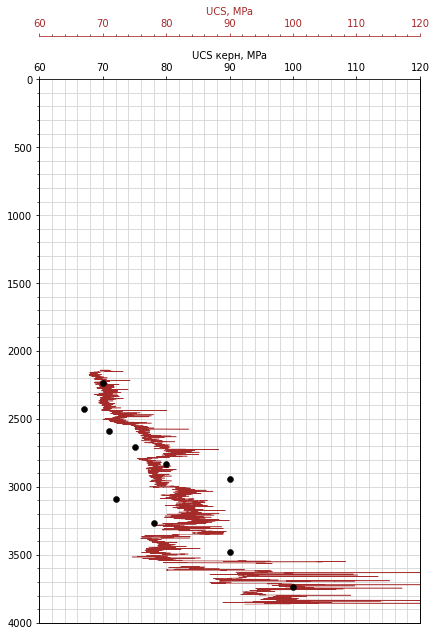

In [49]:
fig,axes = plt.subplots(figsize=(15,10))
        
ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax2 = ax1.twiny()

#UCS
ax1.plot(df['UCS'],df['MD'], color='brown', lw=0.5)
ax1.set_xlim(60, 120)
ax1.set_xlabel('UCS, MPa')
ax1.xaxis.label.set_color('brown')
ax1.spines['top'].set_position(('axes', 1.08))
ax1.tick_params(axis='x', colors='brown')
ax1.spines['top'].set_edgecolor('brown')
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.minorticks_on()
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set_ylim(4000, 2000)

#UCS_core
ax2.scatter(df['UCS_core'],df['MD'], color='k', lw=0.5)
ax2.set_xlim(60, 120)
ax2.set_xlabel('UCS керн, MPa')
ax2.set_ylabel('MD, m')
ax2.xaxis.label.set_color('k')
ax2.spines['top'].set_position(('axes', 1.00))
ax2.tick_params(axis='x', colors='k')
ax2.spines['top'].set_edgecolor('k')
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')
ax2.set_ylim(4000, 0)

# (4) Расчёт напряжений по пороупругой модели

In [50]:
import plotly.graph_objects as go
from ipywidgets import widgets

import chart_studio.plotly as py
from plotly.graph_objs import *
from numpy.linalg import multi_dot
import plotly.express as px
import plotly.offline as pyo
pyo.init_notebook_mode()

import mplstereonet

In [51]:
# расчёт горизонтальных напряжений
def horizontal_stresses_poroelastic(df):
    df['Shmin'] = nan
    df['SHmax'] = nan
    global epsilon_small_h
    global epsilon_big_h
    global biot
    for i, row in df.iterrows():
        if not isnan(df.at[i, 'DTC']):
            nu = df.at[i,'PR_sta']
            e = df.at[i,'E_sta']
            s_v = df.at[i,'Overburden']
            p_p = df.at[i,'Hydrostatic']
            #print(nu, e, s_v, p_p)
            df.at[i,'Shmin'] = nu/(1-nu)*(s_v-biot*p_p)+biot*p_p+e*1000/(1-nu**2)*(epsilon_small_h+nu*epsilon_big_h)
            df.at[i,'SHmax'] = nu/(1-nu)*(s_v-biot*p_p)+biot*p_p+e*1000/(1-nu**2)*(epsilon_big_h+nu*epsilon_small_h)
    return df

epsilon_small_h = 0.00001
epsilon_big_h = 0.0001
biot = 1
    
df = horizontal_stresses_poroelastic(df)

## Построение полигона

In [52]:
def polygon(s_v, p_p, mu):
    fmu = ((mu**2 + 1)**0.5 + mu)**2
    #точка 1
    x1 = (s_v - p_p) / fmu + p_p
    y1 = (s_v - p_p) / fmu + p_p
    #точка 2
    x2 = (s_v - p_p) / fmu + p_p
    y2 = s_v
    #точка 3
    x3 = s_v
    y3 = (s_v - p_p) * fmu + p_p
    #точка 4
    x4 = (s_v - p_p) * fmu + p_p
    y4 = (s_v - p_p) * fmu + p_p
    #точка 5 (s_v)
    x5 = s_v
    y5 = s_v
    
    s_hmin_border = [x1, x2, x3, x4, x1]
    s_Hmax_border = [y1, y2, y3, y4, y1]
    s_hmin_inside = [x2, x5, x3]
    s_Hmax_inside = [y2, y5, y3]
    
    return s_hmin_border, s_Hmax_border, s_hmin_inside, s_Hmax_inside

def breakouts_constraint(ucs, p_p, dp, wbo, s_hmin):
    s_Hmax = ((ucs+2*p_p+dp)-s_hmin*(1+2*cos(pi-np.radians(wbo))))/(1-2*cos(pi-np.radians(wbo)))
    return s_Hmax

def tensile_constraint(tstr, p_p, dp,  s_hmin):
    s_Hmax = 3 * s_hmin - 2 * p_p - dp - tstr
    return s_Hmax
    

s_v = 100
visible_p_p = 40
# Создание нового пространства для построения графиков
fig = go.Figure()

# Создание все возможные вариации полигона для различных пластовых давлений
for p_p in np.arange(0, s_v, 1):
    fig.add_traces([
        go.Scatter(
            visible = False,
            x=polygon(s_v, p_p, 0.6)[0],
            y=polygon(s_v, p_p, 0.6)[1],
            line=dict(color="#00CED1", width=1)),
        go.Scatter(
            visible = False,
            x=polygon(s_v, p_p, 0.6)[2],
            y=polygon(s_v, p_p, 0.6)[3],
            line=dict(color="#00CED1", width=1)),
        go.Scatter(
            visible = False,
            x=np.arange(0, 300, 1),
            y=breakouts_constraint(80, p_p, 10, 45, np.arange(0, 300, 1)),
            line=dict(color="red", width=1)),
        go.Scatter(
            visible = False,
            x=np.arange(0, 300, 1),
            y=tensile_constraint(5, p_p, 0, np.arange(0, 300, 1)),
            line=dict(color="green", width=1))])
    fig.update_layout(yaxis_range=[0,400])
    fig.update_layout(xaxis_range=[0,400])

# Активный вариант полигона на графике (40 МПа пластового давления)
fig.data[visible_p_p*2].visible = True
fig.data[visible_p_p*2+1].visible = True
fig.data[visible_p_p*2+2].visible = True
fig.data[visible_p_p*2+3].visible = True

# Добавляем ползунок
steps = []
for i in range(len(fig.data)):
    if i%4 == 0:
        step = dict(
            method="update",
            args=[{"visible": [False] * len(fig.data)},
                  {"title": "Текущее значение пластового давления: " + str(i/2) + " МПа"}],  # layout attribute
        )
        step["args"][0]["visible"][i] = True  # Toggle i'th trace to "visible"
        step["args"][0]["visible"][i+1] = True 
        step["args"][0]["visible"][i+2] = True 
        step["args"][0]["visible"][i+3] = True 
        steps.append(step)
    
sliders = [dict(active=40,
                currentvalue={"prefix": "Пластовое давление: "},
                pad={"t": 40},
                steps=steps)]

fig.update_layout(
    sliders=sliders
)

        
fig.show()
fig.write_html("polygon.html")

In [53]:
# функция для расчёта горизонтальных напряжений
def horizontal_stresses_FFT(df, mu):
    fmu = ((mu**2 + 1)**0.5 + mu)**2
    df['Shmin_FFT'] = nan
    df['SHmax_FFT'] = nan
    for i, row in df.iterrows():
        if not isnan(df.at[i, 'DTC']):
            s_v = df.at[i,'Overburden']
            p_p = df.at[i,'Hydrostatic']
            df.at[i,'Shmin_FFT'] = (s_v-p_p)/fmu+p_p
            df.at[i,'SHmax_FFT'] = (s_v-p_p)*fmu+p_p
    return df

In [54]:
# функция для построения матрицы горных напряжений   
def ss(s_v, s_Hmax, s_hmin):
    s_s = [s_v, s_Hmax, s_hmin]
    s_s.sort(reverse=True)
    s_s = np.diag(s_s)
    return s_s

def r1(s_v, s_Hmax, s_hmin):
    if s_v >= s_Hmax and s_Hmax >= s_hmin:
        alpha = radians(0)
        beta = radians(90)
        gamma = radians(0)
    elif s_Hmax >= s_v and s_v >= s_hmin:
        alpha = radians(90)
        beta = radians(0)
        gamma = radians(90)
    elif s_Hmax >= s_v and s_Hmin >= s_v:
        alpha = radians(90)
        beta = radians(0)
        gamma = radians(0)  
    r_1 = [[cos(alpha)*cos(beta),
           sin(alpha)*cos(beta),
           -sin(beta)],
        [cos(alpha)*sin(beta)*sin(gamma)-sin(alpha)*cos(gamma),
         sin(alpha)*sin(beta)*sin(gamma)+cos(alpha)*cos(gamma),
         cos(beta)*sin(gamma)],
        [cos(alpha)*sin(beta)*cos(gamma)+sin(alpha)*sin(gamma),
         sin(alpha)*sin(beta)*cos(gamma)-cos(alpha)*sin(gamma),
         cos(beta)*cos(gamma)]]
    return r_1

def r2(strike, dip):
    r_2 = [[cos(strike),
          sin(strike),
          0],
          [sin(strike)*cos(dip),
           -cos(strike)*cos(dip),
           -sin(dip)],
          [-sin(strike)*sin(dip),
           cos(strike)*sin(dip),
           -cos(dip)]]
    return r_2

def r3(s_f):
    if s_f[2][1] > 0 and s_f[2][0] != 0:
          rake = atan(s_f[2][1] / s_f[2][0])
    elif s_f[2][1] < 0 and s_f[2][0] > 0:
          rake = 2 * pi - atan(-s_f[2][1] / s_f[2][0])
    else:
          rake = atan(-s_f[2][1] / (-s_f[2][0])) - 2 * pi
    r_3 = [[cos(rake),
          sin(rake),
          0],
          [-sin(rake),
           cos(rake),
           0],
          [0,
          0,
          1]]
    return r_3

def fault_stresses(s_v, s_Hmax, s_hmin, strike, dip):
    
    s_s = ss(s_v, s_Hmax, s_hmin)

    r_1 = r1(s_v, s_Hmax, s_hmin)
    r_1_T = [list(i) for i in zip(*r_1)]

    s_g = multi_dot([r_1_T, s_s, r_1])

    r_2 = r2(strike, dip)
    r_2_T = [list(i) for i in zip(*r_2)]

    s_f = multi_dot([r_2, s_g, r_2_T])

    r_3 = r3(s_f)
    r_3_T = [list(i) for i in zip(*r_3)]

    s_r = multi_dot([r_3, s_f, r_3_T])

    tau_n = s_r[2][0]
    sigma_n = s_f[2][2]
    
    return tau_n, sigma_n
    
def fault_slip(s_v, s_Hmax, s_hmin, strike, dip, p_p, mu):
    tau_n, sigma_n = fault_stresses(s_v, s_Hmax, s_hmin, strike, dip)
    return (tau_n / (sigma_n - p_p) > mu)

fault_slip(80, 70, 65, np.radians(35), np.radians(60), 30, 0.6)         

False

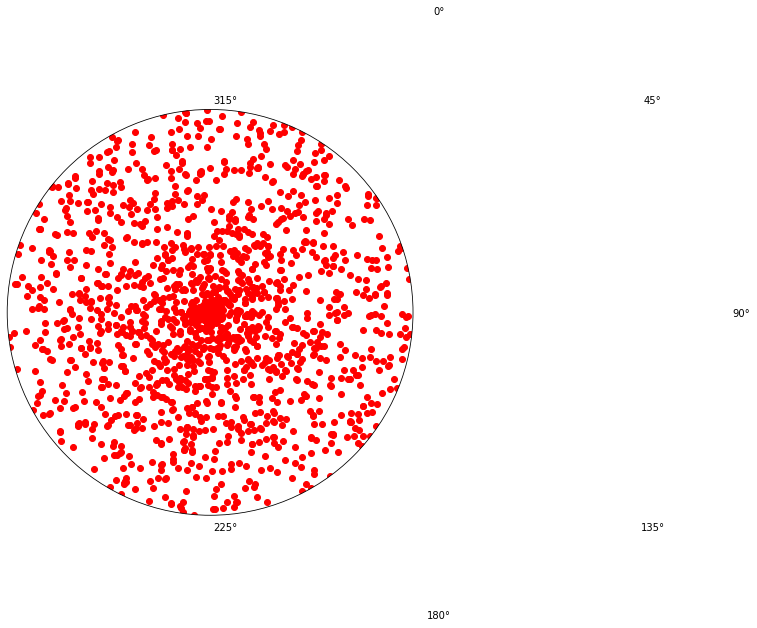

In [55]:
def create_plot(s_v, s_Hmax, s_hmin, p_p, mu):

    strikes = np.random.rand(10000) * 360
    dips =  np.random.rand(10000) * 90

    stresses = np.array([fault_stresses(s_v, s_Hmax, s_hmin, strikes[i], dips[i]) for i in range(len(strikes))])
    classes = np.array([fault_slip(s_v, s_Hmax, s_hmin, strikes[i], dips[i], p_p, mu) for i in range(len(strikes))])
    
    df_faults = pd.DataFrame({'sigma_n': stresses[:,1],
                              'tau_n': stresses[:,0],
                              'class':classes,
                              'strike':strikes,
                              'dip':dips})
    df_faults = df_faults.drop(df_faults[df_faults['tau_n']<0].index)
    
    fig = px.scatter(df_faults, x="sigma_n", y="tau_n", color="class",
                     color_discrete_map= {True: 'red',
                                      False: 'black'})
    fig.layout.yaxis.scaleanchor="x"
    fig.show()
    
    
    fig_stereonet = plt.figure(figsize=(16,8))

    ax = fig_stereonet.add_subplot(121, projection='stereonet')
    
    df_activated =  df_faults[df_faults['class'] == True]
    
    
    ax.pole(df_activated['strike'], df_activated['dip'], c='r')
    
create_plot(100, 60, 20, 10, 0.6)

# (5) Расчёт устойчивости вдоль главных напряжений

In [56]:
# сохранение данных в .csv файл
df.to_csv('data_summary.csv', encoding='utf-8', sep=';', index=False)

In [57]:
# импорт данных из .csv файла
df = pd.read_csv('data_summary.csv', sep=';', low_memory=False)
df

,MD,AZI,BS,CALI,DCAL,DEV,DRHO,DTC,DTS,GR,NPHI,PEF,RDEP,RHOB,RMED,TVD,EAST,NORTH,DISPLACEMENT,Overburden,RHOB_extrapolated,Hydrostatic,Hydrostatic Gradient,VSH,DTC Trend,Eaton,Eaton Gradient,Overburden_low,RHOB_extrapolated_low,DTC_Trend_low,Eaton_low,Eaton Gradient_low,E_dyn,PR_dyn,Interval,E_sta_core,PR_sta_core,DTS_core,DTC_core,RHOB_core,E_dyn_core,PR_dyn_core,E_sta_global,PR_sta_global,E_sta,PR_sta,FANG_core,UCS_core,BRAZ_core,UCS,BRAZ,FANG,Shmin,SHmax
0,0.0,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.0,0.0,0.0,0.0,0.000000,0.000000,0.000,NaN,NaN,NaN,0.000,NaN,0.000000,0.000000,NaN,0.000,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,0.1,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.1,0.0,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0,0.000000,0.000000,NaN,0.000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,0.2,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.2,0.0,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0,0.000000,0.000000,NaN,0.000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,0.3,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.3,0.0,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0,0.000000,0.000000,NaN,0.000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
4,0.4,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,0.4,0.0,0.0,0.0,0.000000,0.000000,0.000,0.0,0.0,NaN,0.000,0.0,0.000000,0.000000,NaN,0.000,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
39027,3902.7,0.0,8.5,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,2.970829,NaN,3.087276,3902.7,0.0,0.0,0.0,84.442570,2.506588,38.967,10.0,0.0,274.396787,39.027,10.0,75.801667,2.553632,254.396787,39.027,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39028,3902.8,0.0,8.5,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,2.960968,NaN,3.078955,3902.8,0.0,0.0,0.0,84.445029,2.506600,38.968,10.0,0.0,274.388510,39.028,10.0,75.804173,2.553658,254.388510,39.028,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39029,3902.9,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3902.9,0.0,0.0,0.0,84.447488,2.506611,38.969,10.0,0.0,274.380234,39.029,10.0,75.806678,2.553684,254.380234,39.029,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
39030,3903.0,0.0,NaN,NaN,NaN,0.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,3903.0,0.0,0.0,0.0,84.449947,2.506623,38.970,10.0,0.0,274.371957,39.030,10.0,75.809183,2.553710,254.371957,39.030,10.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [58]:
s_v = 1
s_Hmax = 0.9 * s_v
s_hmin = 0.6 * s_v

mw = 0.44 * s_v
p_p = 0.44 * s_v
ucs = 0.3 * s_v
pr = 0.35
tstr = 0.1 * ucs

fang = 45
q = (1 + sin(radians(fang))) / (1 - sin(radians(fang)))
# функция угла внутреннего трения
mu = tan(radians(fang))
F = ((mu**2 + 1)**0.5 + mu)**2
r_w = 1

def borehole_stresses(s_v, s_Hmax, s_hmin, p_p, pr, theta, r, R):
    sigma_rr = 0.5*(s_Hmax+s_hmin-2*p_p)*(1-R**2/r**2)+0.5*(s_Hmax-s_hmin)*(1-4*R**2/r**2+3*R**4/r**4)*cos(2*theta)+(mw-p_p)*R**2/r**2
    sigma_tt = 0.5*(s_Hmax+s_hmin-2*p_p)*(1+R**2/r**2)-0.5*(s_Hmax-s_hmin)*(1+3*R**4/r**4)*cos(2*theta)-(mw-p_p)*R**2/r**2
    tau_rt = 0.5*(s_Hmax-s_hmin)*(1+2*R**2/r**2-3*R**4/r**4)*sin(2*theta)
    sigma_zz = s_v-2*pr*(s_Hmax-s_hmin)*R**2/r**2*cos(2*theta)-p_p
    return sigma_rr, sigma_tt, tau_rt, sigma_zz

In [59]:
sigma_rr_mesh = []
sigma_tt_mesh = []
tau_rt_mesh = []
sigma_zz_mesh = []

for theta in np.arange(0, 2 * np.pi, 2*np.pi/360):
    sigma_rr_list=[]
    sigma_tt_list=[]
    tau_rt_list=[]
    sigma_zz_list=[]
    for r in np.arange(r_w, 1.5*r_w, (1.5*r_w-r_w)/50):
        sigma_rr, sigma_tt, tau_rt, sigma_zz = borehole_stresses(s_v, s_Hmax, s_hmin, p_p, pr, theta, r, r_w)
        
        sigma_rr_list.append(sigma_rr)
        sigma_tt_list.append(sigma_tt)
        tau_rt_list.append(tau_rt)
        sigma_zz_list.append(sigma_zz)
    
    sigma_rr_mesh.append(sigma_rr_list)
    sigma_tt_mesh.append(sigma_tt_list)
    tau_rt_mesh.append(tau_rt_list)
    sigma_zz_mesh.append(sigma_zz_list)    

sigma_rr_plot = [i[0] for i in sigma_rr_mesh]
sigma_tt_plot = [i[0] for i in sigma_tt_mesh]
tau_rt_plot = [i[0] for i in tau_rt_mesh]
sigma_zz_plot = [i[0] for i in sigma_zz_mesh]
    
sigma_rr_mesh = np.array(sigma_rr_mesh)
sigma_tt_mesh = np.array(sigma_tt_mesh)
tau_rt_mesh = np.array(tau_rt_mesh)
sigma_zz_mesh = np.array(sigma_zz_mesh)

print(np.round(sigma_zz_mesh.max(), 10))
print(np.round(sigma_tt_mesh.max(), 10))
#print(sigma_tt_plot)

0.77
1.22


[[0.         0.         0.         ... 0.         0.         0.        ]
 [0.01750191 0.01750191 0.01750191 ... 0.01750191 0.01750191 0.01750191]
 [0.03500382 0.03500382 0.03500382 ... 0.03500382 0.03500382 0.03500382]
 ...
 [6.24818149 6.24818149 6.24818149 ... 6.24818149 6.24818149 6.24818149]
 [6.2656834  6.2656834  6.2656834  ... 6.2656834  6.2656834  6.2656834 ]
 [6.28318531 6.28318531 6.28318531 ... 6.28318531 6.28318531 6.28318531]]


/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/3383358806.py:25: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/3383358806.py:31: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/3383358806.py:37: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be removed two minor releases later; please call grid(False) first.

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/3383358806.py:43: MatplotlibDeprecationWarning:

Auto-removal of grids by pcolor() and pcolormesh() is deprecated since 3.5 and will be re

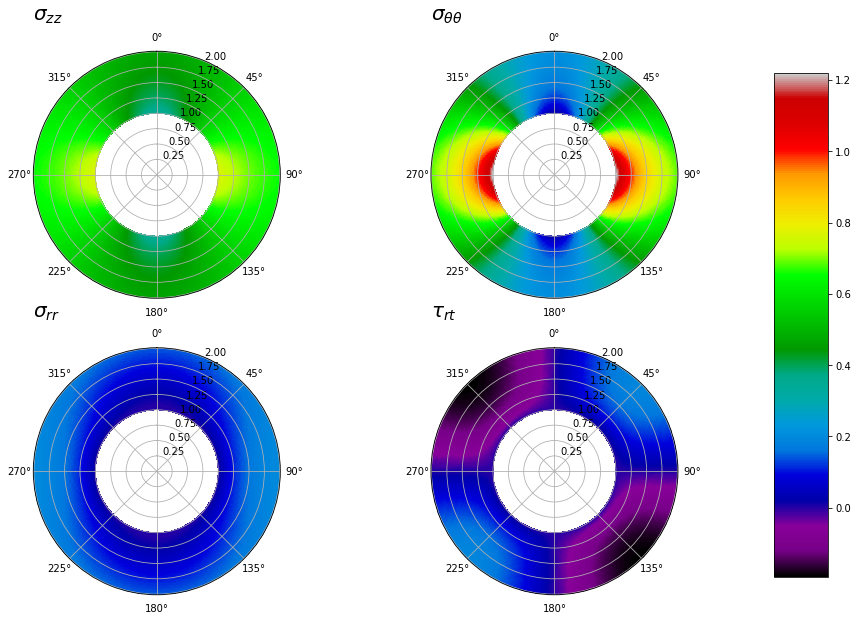

In [60]:
radius = np.linspace(r_w, 2*r_w, 50)
theta = np.linspace(0, 2*pi, 360)
r_mesh, th_mesh = np.meshgrid(radius, theta) 

print(th_mesh)

fig = plt.figure(figsize=(15,10))

ax1 = fig.add_subplot(221, projection="polar")
ax2 = fig.add_subplot(222, projection="polar")
ax3 = fig.add_subplot(223, projection="polar")
ax4 = fig.add_subplot(224, projection="polar")

values = np.concatenate([sigma_rr_mesh.flatten(),
                         sigma_tt_mesh.flatten(),
                         tau_rt_mesh.flatten(),
                         sigma_zz_mesh.flatten()], axis=0)
min_, max_ = values.min(), values.max()
#print(min_, max_)
colormap = 'nipy_spectral'
#plt.subplot(projection="polar")

#norm = Normalize(min_, max_)

cax1 = ax1.pcolormesh(th_mesh, r_mesh, sigma_zz_mesh, vmin=min_, vmax=max_, cmap=colormap)
ax1.grid()
ax1.set_theta_zero_location("N")
ax1.set_theta_direction(-1)
ax1.set_title(r'$\sigma_{zz}$', y=1.1, loc='left', fontdict={'fontsize':20})

cax2 = ax2.pcolormesh(th_mesh, r_mesh, sigma_tt_mesh, vmin=min_, vmax=max_, cmap=colormap)
ax2.grid()
ax2.set_theta_zero_location("N")
ax2.set_theta_direction(-1)
ax2.set_title(r'$\sigma_{\theta\theta}$', y=1.1, loc='left', fontdict={'fontsize':20})

cax3 = ax3.pcolormesh(th_mesh, r_mesh, sigma_rr_mesh, vmin=min_, vmax=max_, cmap=colormap)
ax3.grid()
ax3.set_theta_zero_location("N")
ax3.set_theta_direction(-1)
ax3.set_title(r'$\sigma_{rr}$', y=1.1, loc='left', fontdict={'fontsize':20})

cax4 = ax4.pcolormesh(th_mesh, r_mesh, tau_rt_mesh, vmin=min_, vmax=max_, cmap=colormap)
ax4.grid()
ax4.set_theta_zero_location("N")
ax4.set_theta_direction(-1)
ax4.set_title(r'$\tau_{rt}$', y=1.1, loc='left', fontdict={'fontsize':20})

fig.subplots_adjust(right=0.8)
# put colorbar at desire position
cbar_ax = fig.add_axes([0.85, 0.15, 0.05, 0.7])
fig.colorbar(cax1, cax=cbar_ax)

fig.savefig('Kirsch_Stresses', facecolor='white')
plt.show()

In [61]:
from plotly.subplots import make_subplots

radius = np.linspace(r_w, 2*r_w, 50)
theta = np.linspace(0, 360, 360)
r_mesh, th_mesh = np.meshgrid(radius, theta)

fig = make_subplots(rows=2, cols=2,
                   specs=[[{'type': 'polar'}, {'type': 'polar'}],
                          [{'type': 'polar'}, {'type': 'polar'}]])

fig.add_trace(
    go.Scatterpolar(r=r_mesh.flatten(),
                    theta=th_mesh.flatten(),
                    customdata=sigma_zz_mesh.flatten(),
                    mode="markers",
                    opacity=0.75,
                    marker_color=sigma_zz_mesh.flatten(),
                    marker_colorscale='rainbow',
                    marker_colorbar={'len': 0.5, 'x': 0.4, 'y': 0.8},
                    hovertemplate='<br>r:%{r}<br>theta:%{theta}<br>mark:%{customdata}',
                    ),
    row=1,
    col=1
)

fig.add_trace(
    go.Scatterpolar(r=r_mesh.flatten(),
                    theta=th_mesh.flatten(),
                    customdata=sigma_tt_mesh.flatten(),
                    mode="markers",
                    opacity=0.75,
                    marker_color=sigma_tt_mesh.flatten(),
                    marker_colorscale='rainbow',
                    marker_colorbar={'len': 0.5, 'x': 0.95, 'y': 0.8},
                    hovertemplate='<br>r:%{r}<br>theta:%{theta}<br>mark:%{customdata}',
                    ),
    row=1,
    col=2
)

fig.add_trace(
    go.Scatterpolar(r=r_mesh.flatten(),
                    theta=th_mesh.flatten(),
                    customdata=sigma_rr_mesh.flatten(),
                    mode="markers",
                    opacity=0.75,
                    marker_color=sigma_rr_mesh.flatten(),
                    marker_colorscale='rainbow',
                    marker_colorbar={'len': 0.5, 'x': 0.4, 'y': 0.2},
                    hovertemplate='<br>r:%{r}<br>theta:%{theta}<br>mark:%{customdata}',
                    ),
    row=2,
    col=1
)

fig.add_trace(
    go.Scatterpolar(r=r_mesh.flatten(),
                    theta=th_mesh.flatten(),
                    customdata=tau_rt_mesh.flatten(),
                    mode="markers",
                    opacity=0.75,
                    marker_color=tau_rt_mesh.flatten(),
                    marker_colorscale='rainbow',
                    marker_colorbar={'len': 0.5, 'x': 0.95, 'y': 0.2},
                    hovertemplate='<br>r:%{r}<br>theta:%{theta}<br>mark:%{customdata}',
                    ),
    row=2,
    col=2
)


#pyo.plot(fig)
fig

In [62]:
px.scatter_polar(r=r_mesh.flatten(), theta=th_mesh.flatten(), color=sigma_tt_mesh.flatten())

[[  0.           0.           0.         ...   0.           0.
    0.        ]
 [  1.00278552   1.00278552   1.00278552 ...   1.00278552   1.00278552
    1.00278552]
 [  2.00557103   2.00557103   2.00557103 ...   2.00557103   2.00557103
    2.00557103]
 ...
 [357.99442897 357.99442897 357.99442897 ... 357.99442897 357.99442897
  357.99442897]
 [358.99721448 358.99721448 358.99721448 ... 358.99721448 358.99721448
  358.99721448]
 [360.         360.         360.         ... 360.         360.
  360.        ]]


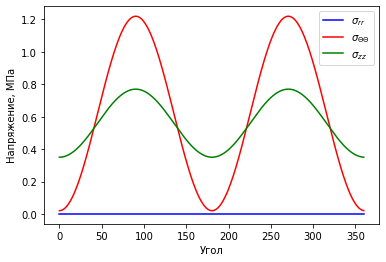

In [63]:
theta = np.linspace(0, 360, 360)

fig = plt.subplots()

print(th_mesh)

plt.plot(theta, sigma_rr_plot, color='b', label='$\sigma_{rr}$')
plt.plot(theta, sigma_tt_plot, color='r', label='$\sigma_{\Theta \Theta}$')
plt.plot(theta, sigma_zz_plot, color='g', label='$\sigma_{zz}$')

plt.xlabel("Угол")
plt.ylabel("Напряжение, МПа")

plt.legend()

plt.show()

In [64]:
def gradients(df, axial, max_side, min_side, breakout_variant):
    df[breakout_variant] = nan
    df['Losses'] = nan
    df['Fracture'] = nan
    df['Pp gradient'] = nan
    
    # identity_matrix = np.identity(3)
    
    for i, row in df.iterrows():
        #расчёт только на тех глубинах, где есть данные DTP
        if not pd.isna(row['DTC']):
            #задание переменных для расчёта
            s_v = df.at[i, axial]
            s_hmin = df.at[i, min_side]
            s_Hmax = df.at[i, max_side]
            p_p = df.at[i, 'Hydrostatic']
            pr = df.at[i, 'PR_sta']
            ucs = df.at[i, 'UCS']
            tstr = df.at[i, 'BRAZ']
            tvd = df.at[i, 'TVD']
            fang = df.at[i, 'FANG']
            #print(s_v, s_hmin, s_Hmax, p_p, pr, ucs, tstr, tvd, fang)
            #функция угла внутреннего трения
            mu = tan(radians(fang))
            F = ((mu**2 + 1)**0.5 + mu)**2
            sigma_rr, sigma_tt, tau_rt, sigma_zz = borehole_stresses(s_v, s_Hmax, s_hmin, p_p, pr, pi/2, r_w, r_w)
            if sigma_tt >= sigma_zz:
                df.at[i, breakout_variant] = (p_p + (2 * s_Hmax - s_hmin - 2 * p_p - ucs / 2) / (1 + F)) / (9.81 * tvd) * 1000
            elif sigma_tt < sigma_zz:
                df.at[i, breakout_variant] = (p_p + (s_v + 2 * pr * (s_Hmax - s_hmin) - p_p - ucs / 2))/ F / (9.81 * tvd) * 1000
            #поиск градиента поглощений как градиента Shmin
            df.at[i, 'Losses'] = min(s_hmin, s_v) / (9.81 * tvd) * 1000
            #поиск градиента ГРП
            df.at[i, 'Fracture'] = (3 * s_hmin - s_Hmax - p_p + tstr) / (9.81 * tvd) * 1000
            #поиск градиента пластового давления
            df.at[i, 'Pp gradient'] = p_p / (9.81 * tvd) * 1000
    return df

In [65]:
df = gradients(df, 'Overburden', 'SHmax', 'Shmin', 'Breakout_Overburden')
print(df['Breakout_Overburden'].max())

0.722159745573623


/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/4149440013.py:5: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.

/var/folders/ng/hg0wb8y956zfbdtbvbqtd90h0000gn/T/ipykernel_5090/4149440013.py:9: MatplotlibDeprecationWarning:

Auto-removal of overlapping axes is deprecated since 3.6 and will be removed two minor releases later; explicitly call ax.remove() as needed.



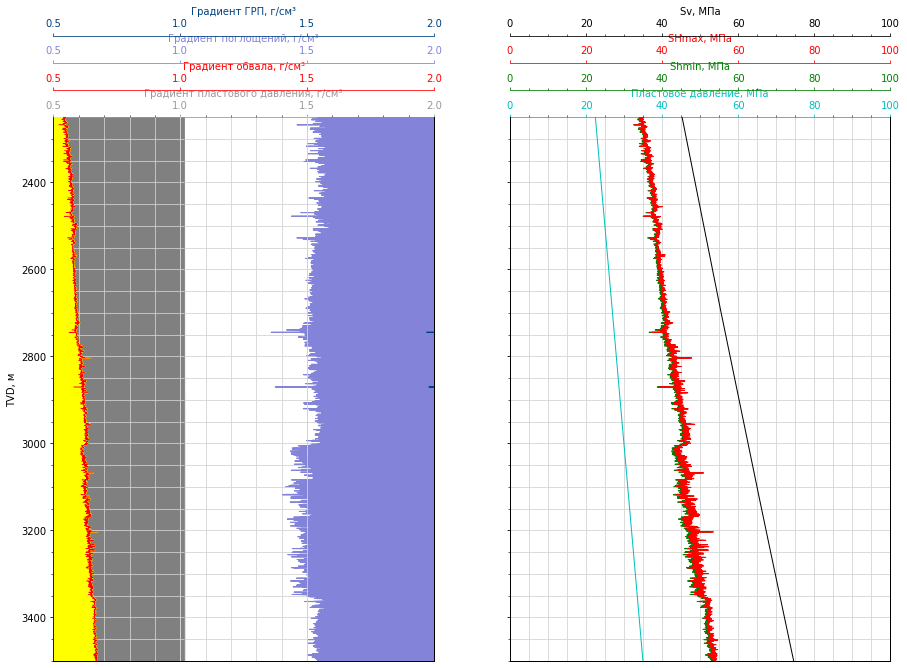

In [66]:
#Построение совмещённых графиков давлений

fig,axes = plt.subplots(1,2, figsize=(15,10))

ax1 = plt.subplot2grid((1,2), (0,0), rowspan=1, colspan=1)
ax2 = ax1.twiny()
ax3 = ax2.twiny()
ax4 = ax3.twiny()
ax5 = plt.subplot2grid((1,2), (0,1), rowspan=1, colspan=1)
ax6 = ax5.twiny()
ax7 = ax5.twiny()
ax8 = ax5.twiny()

#Градиент пластового давления
ax1.plot(df['Pp gradient'],df['TVD'], color='#999999', lw=0.5)
ax1.set_xlim(0.5,2)
ax1.set_xlabel('Градиент пластового давления, г/см³')
ax1.xaxis.label.set_color('#999999')
ax1.spines['top'].set_position(('axes', 1.0))
ax1.tick_params(axis='x', colors='#999999')
ax1.spines['top'].set_edgecolor('#999999')
ax1.fill_betweenx(df['TVD'], 0, df['Pp gradient'], color='grey')
ax1.set_xticks([0.5, 1, 1.5, 2])
ax1.set_ylim(3500, 2250)
ax1.grid(which='both', color='lightgrey', linestyle='-')
ax1.minorticks_on()
ax1.tick_params(axis='x', which='minor', labelsize=5)
ax1.xaxis.set_ticks_position('top')
ax1.xaxis.set_label_position('top')
ax1.set(ylabel='TVD, м')
ax1.label_outer()

#Градиент обвалов
ax2.plot(df['Breakout_Overburden'],df['TVD'], color='red', lw=0.5)
ax2.set_xlim(0.5,2)
ax2.set_xlabel('Градиент обвала, г/см³')
ax2.xaxis.label.set_color('red')
ax2.spines['top'].set_position(('axes', 1.05))
ax2.tick_params(axis='x', colors='red')
ax2.spines['top'].set_edgecolor('red')
ax2.fill_betweenx(df['TVD'], 0, df['Breakout_Overburden'], color='yellow')
ax2.set_xticks([0.5, 1, 1.5, 2])
ax2.set_ylim(3500, 2250)
ax2.grid(which='both', color='lightgrey', linestyle='-')
ax2.xaxis.set_ticks_position('top')
ax2.xaxis.set_label_position('top')

#Градиент поглощений
ax3.plot(df['Losses'],df['TVD'], color='#8383d9', lw=0.5)
ax3.set_xlim(0.5,2)
ax3.set_xlabel('Градиент поглощений, г/см³')
ax3.xaxis.label.set_color('#8383d9')
ax3.spines['top'].set_position(('axes', 1.10))
ax3.tick_params(axis='x', colors='#8383d9')
ax3.spines['top'].set_edgecolor('#8383d9')
ax3.fill_betweenx(df['TVD'], df['Losses'], 3, color='#8383d9')
ax3.set_xticks([0.5, 1, 1.5, 2])
ax3.set_ylim(3500, 2250)
ax3.grid(which='both', color='lightgrey', linestyle='-')
ax3.xaxis.set_ticks_position('top')
ax3.xaxis.set_label_position('top')

#Градиент гидроразрыва
ax4.plot(df['Fracture'],df['TVD'], color='#004080', lw=0.5)
ax4.set_xlim(0.5,2)
ax4.set_xlabel('Градиент ГРП, г/см³')
ax4.xaxis.label.set_color('#004080')
ax4.spines['top'].set_position(('axes', 1.15))
ax4.tick_params(axis='x', colors='#004080')
ax4.spines['top'].set_edgecolor('#004080')
ax4.fill_betweenx(df['TVD'], df['Fracture'], 3, color='#004080')
ax4.set_xticks([0.5, 1, 1.5, 2])
ax4.set_ylim(3500, 2250)
ax4.grid(which='both', color='lightgrey', linestyle='-')
ax4.xaxis.set_ticks_position('top')
ax4.xaxis.set_label_position('top')

#Построение профилей напряжений и пластового давления

#Пластовое давление
ax5.grid(zorder=0, which='both', color='lightgrey', linestyle='-')
ax5.plot(df['Hydrostatic'],df['MD'], color='c', lw=1, zorder=2)
ax5.set_xlim(0, 100)
ax5.set_xlabel('Пластовое давление, МПа')
ax5.xaxis.label.set_color('c')
ax5.spines['top'].set_position(('axes', 1.0))
ax5.tick_params(axis='x', colors='c')
ax5.spines['top'].set_edgecolor('c')
ax5.xaxis.set_ticks_position('top')
ax5.xaxis.set_label_position('top')
ax5.minorticks_on()
ax5.set_ylim(3500, 2250)
ax5.set(ylabel='MD, м')
ax5.label_outer()

#Shmin
ax6.plot(df['Shmin'],df['MD'], color='green', lw=1, zorder=2)
ax6.set_xlim(0, 100)
ax6.set_xlabel('Shmin, МПа')
ax6.xaxis.label.set_color('green')
ax6.spines['top'].set_position(('axes', 1.05))
ax6.tick_params(axis='x', colors='green')
ax6.spines['top'].set_edgecolor('green')
ax6.xaxis.set_ticks_position('top')
ax6.xaxis.set_label_position('top')
ax6.minorticks_on()
ax6.set_ylim(3500, 2250)

#SHmax
ax7.plot(df['SHmax'],df['MD'], color='red', lw=1, zorder=2)
ax7.set_xlim(0, 100)
ax7.set_xlabel('SHmax, МПа')
ax7.xaxis.label.set_color('red')
ax7.spines['top'].set_position(('axes', 1.10))
ax7.tick_params(axis='x', colors='red')
ax7.spines['top'].set_edgecolor('red')
ax7.xaxis.set_ticks_position('top')
ax7.xaxis.set_label_position('top')
ax5.minorticks_on()
ax7.set_ylim(3500, 2250)

#Вертикальное напряжение
ax8.plot(df['Overburden'],df['MD'], color='black', lw=1, zorder=2)
ax8.set_xlim(0, 100)
ax8.set_xlabel('Sv, МПа')
ax8.xaxis.label.set_color('black')
ax8.spines['top'].set_position(('axes', 1.15))
ax8.tick_params(axis='x', colors='black')
ax8.spines['top'].set_edgecolor('black')
ax8.xaxis.set_ticks_position('top')
ax8.minorticks_on()
ax8.set_ylim(3500, 2250)
plt.setp(ax8.get_yticklabels(), visible=False)
plt.show()